In [1]:
import scanpy as sc
import scvi
import pandas as pd
import numpy as np
from numpy.linalg import svd
import matplotlib.pyplot as plt
import sklearn
import sklearn.mixture
from collections import defaultdict
from scipy import stats
import seaborn as sns
from statannotations import Annotator
import pathlib
import seaborn as sns
import gseapy as gp

plt.rcParams['figure.figsize'] = [20, 10]
sc.set_figure_params(dpi=300)

Global seed set to 0
/home/x_mamin/.conda/envs/lilliput_env/lib/python3.9/site-packages/pytorch_lightning/utilities/warnings.py:53: LightningDeprecationWarning: pytorch_lightning.utilities.warnings.rank_zero_deprecation has been deprecated in v1.6 and will be removed in v1.8. Use the equivalent function from the pytorch_lightning.utilities.rank_zero module instead.
  new_rank_zero_deprecation(
/home/x_mamin/.conda/envs/lilliput_env/lib/python3.9/site-packages/pytorch_lightning/utilities/warnings.py:58: LightningDeprecationWarning: The `pytorch_lightning.loggers.base.rank_zero_experiment` is deprecated in v1.7 and will be removed in v1.9. Please use `pytorch_lightning.loggers.logger.rank_zero_experiment` instead.
  return new_rank_zero_deprecation(*args, **kwargs)


In [2]:
scvi.__version__

'0.19.0'

In [3]:
adata = sc.read_text("log_normalized_matrix_012020.txt").T

In [4]:
adata.layers["counts"] = adata.X

In [5]:
metadata = pd.read_table("alexandria_structured_metadata.txt", sep="\t")

/tmp/ipykernel_392428/1060024069.py:1: DtypeWarning: Columns (21,26,27,30,33) have mixed types. Specify dtype option on import or set low_memory=False.
  metadata = pd.read_table("alexandria_structured_metadata.txt", sep="\t")


In [6]:
metadata = metadata.iloc[1:, :]

In [7]:
for col in metadata.columns:
    adata.obs[col] = metadata[col].values

In [8]:
adata.obs.keys()

Index(['NAME', 'species', 'species__ontology_label',
       'library_preparation_protocol',
       'library_preparation_protocol__ontology_label', 'donor_id', 'cell_type',
       'cell_type__ontology_label', 'is_living', 'sex', 'organ',
       'organ__ontology_label', 'disease', 'disease__ontology_label',
       'sample_type', 'geographical_region',
       'geographical_region__ontology_label', 'enrichment_method',
       'enrichment__facs_markers', 'enrichment__cell_type',
       'enrichment__cell_type__ontology_label', 'nUMI', 'CellID',
       'biosample_id', 'study_celltype_label', 'TimePoint', 'nGene',
       'percent_mito', 'sequencing_instrument_manufacturer_model',
       'sequencing_instrument_manufacturer_model__ontology_label',
       'paired_ends', 'read_length', 'end_bias', 'organism_age',
       'organism_age__unit_label', 'organism_age__unit'],
      dtype='object')

In [9]:
pd.unique(adata.obs["TimePoint"])

array(['4 Weeks', '6 Months', 'Pre-Infection', '0 Weeks', '1 Week',
       '2 Weeks', '3 Weeks', '1 Year'], dtype=object)

In [10]:
enc_time = {'4 Weeks': 28, '6 Months':182, 'Pre-Infection': -1, '0 Weeks': 0, '1 Week': 7,
       '2 Weeks': 14, '3 Weeks': 21, '1 Year': 365}
adata.obs["TimePoint_cont"] = [enc_time[i] for i in adata.obs["TimePoint"]]

In [11]:
sc.pp.pca(adata)
sc.pp.neighbors(adata)
sc.tl.umap(adata)

#### Check data

species


/home/x_mamin/.conda/envs/lilliput_env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


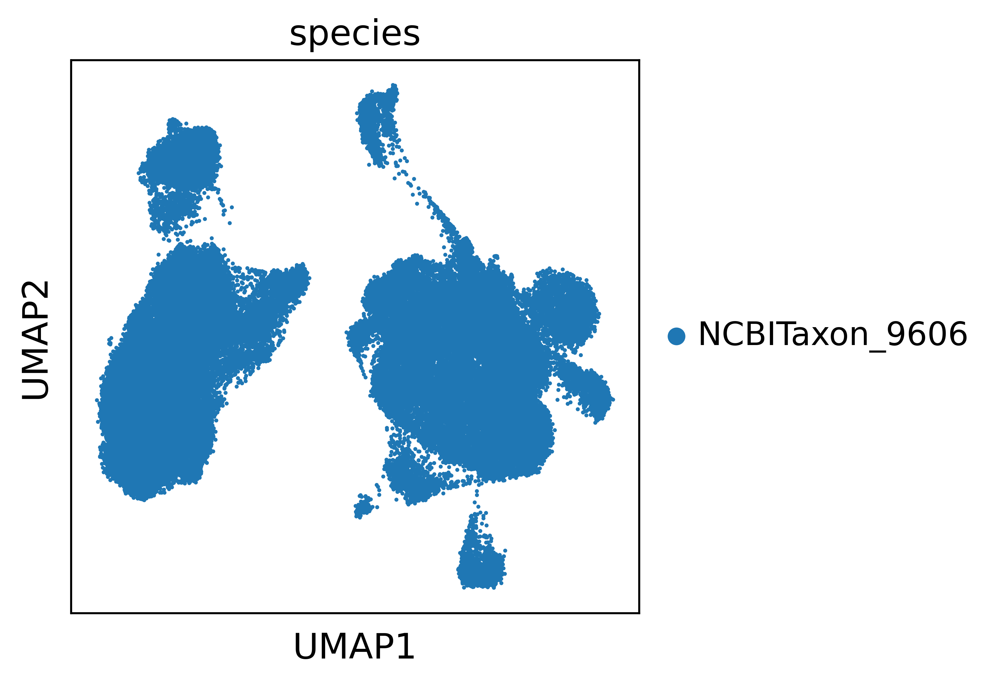

species__ontology_label


/home/x_mamin/.conda/envs/lilliput_env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


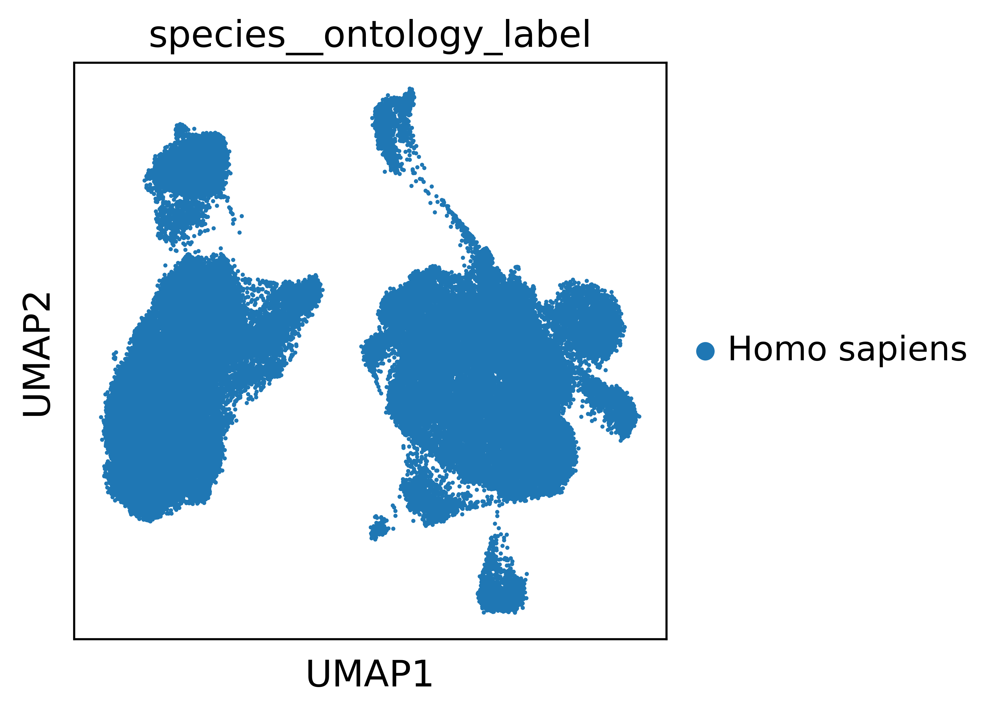

library_preparation_protocol


/home/x_mamin/.conda/envs/lilliput_env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


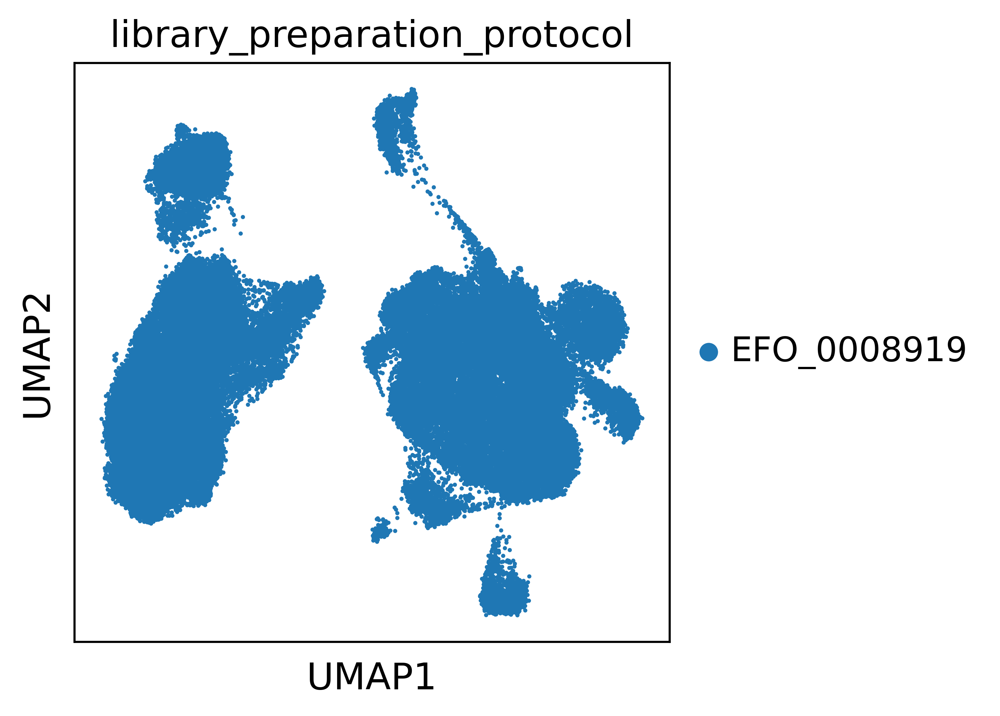

library_preparation_protocol__ontology_label


/home/x_mamin/.conda/envs/lilliput_env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


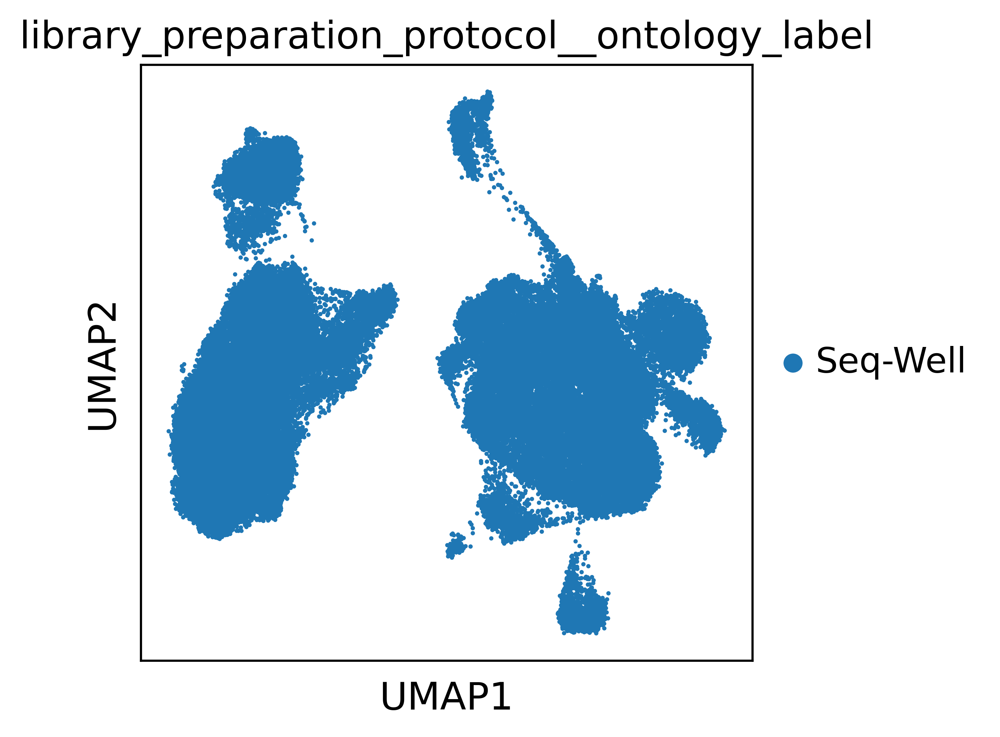

donor_id


/home/x_mamin/.conda/envs/lilliput_env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


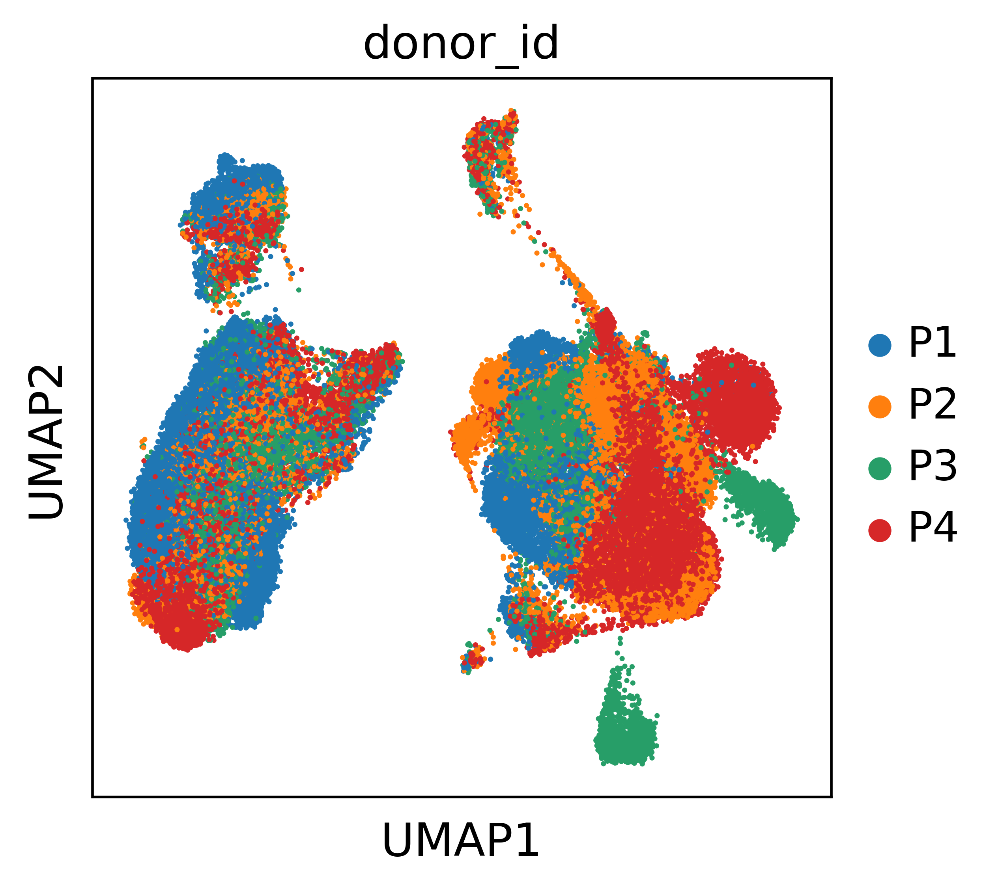

cell_type


/home/x_mamin/.conda/envs/lilliput_env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


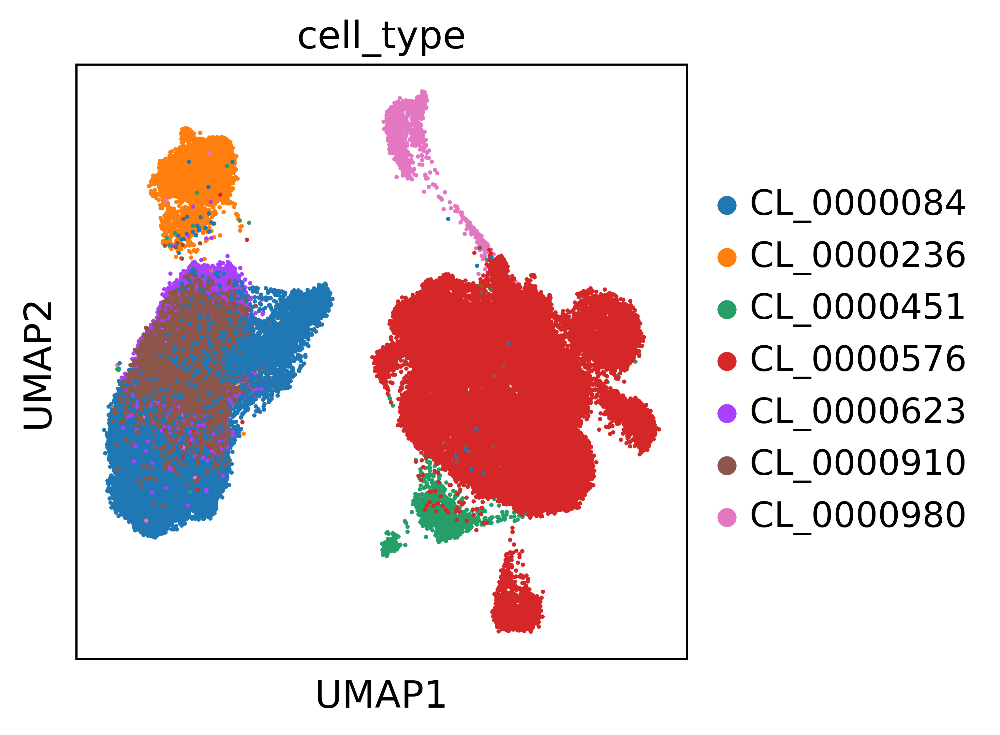

cell_type__ontology_label


/home/x_mamin/.conda/envs/lilliput_env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


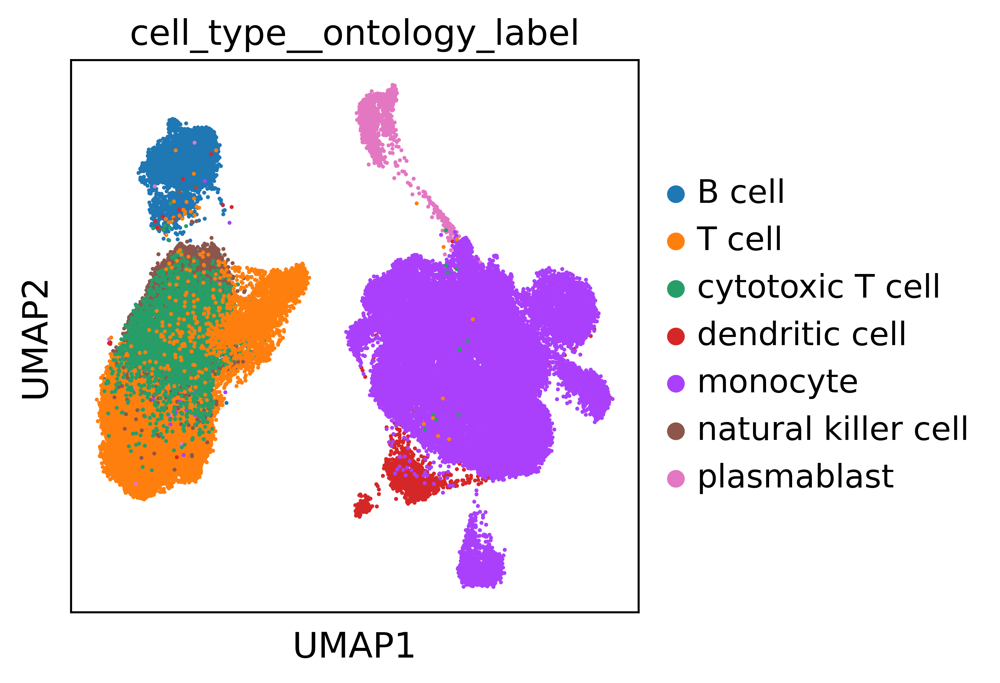

is_living


/home/x_mamin/.conda/envs/lilliput_env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


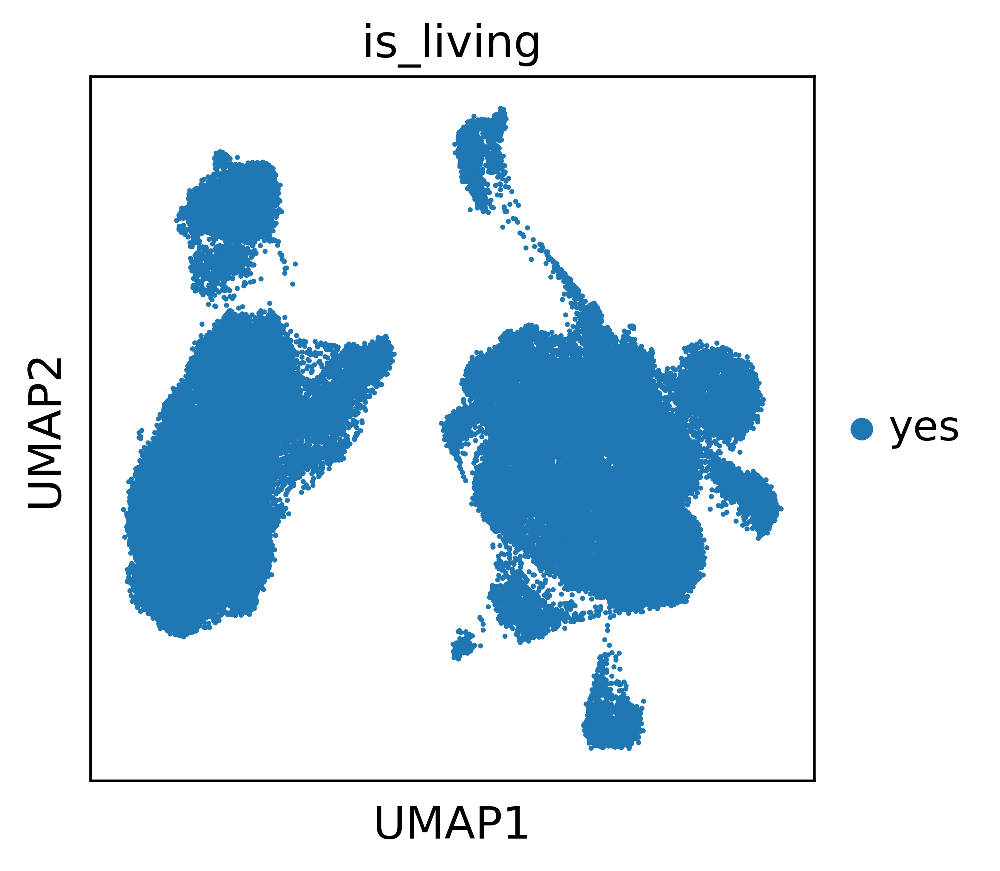

sex


/home/x_mamin/.conda/envs/lilliput_env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


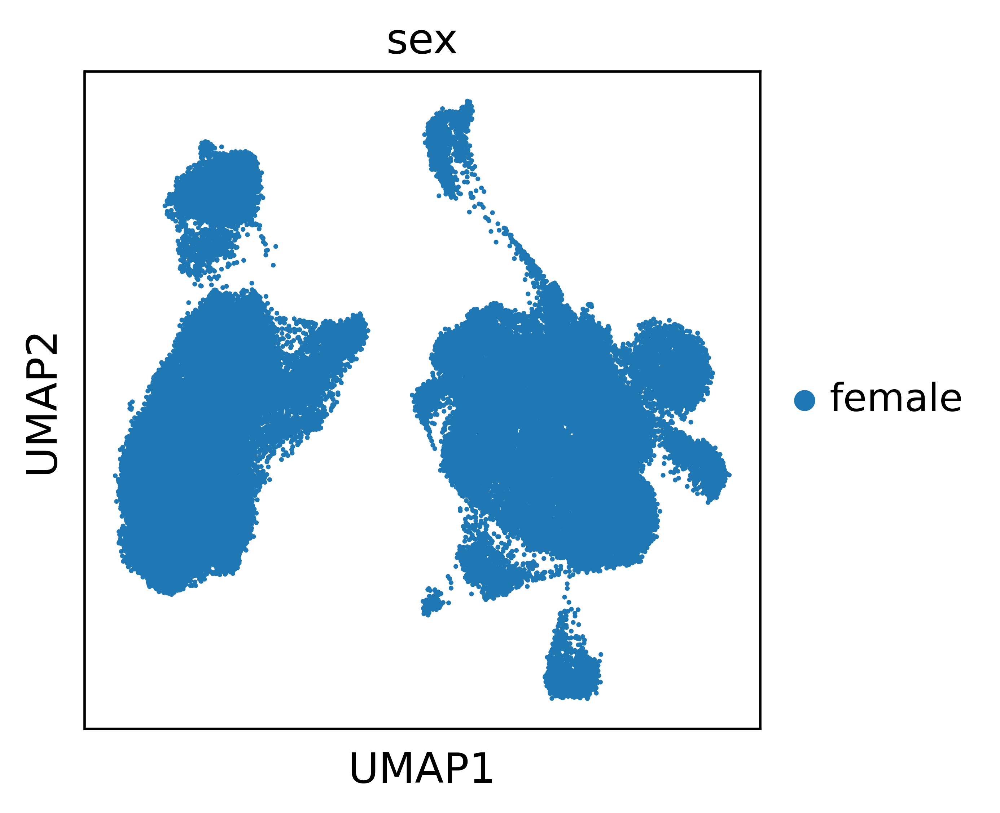

organ


/home/x_mamin/.conda/envs/lilliput_env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


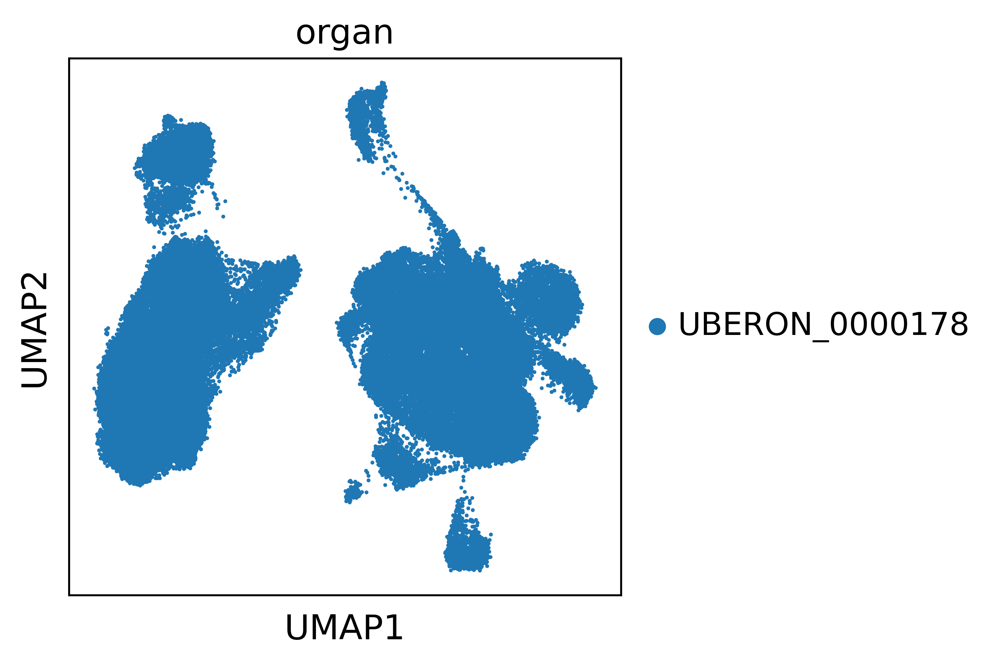

organ__ontology_label


/home/x_mamin/.conda/envs/lilliput_env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


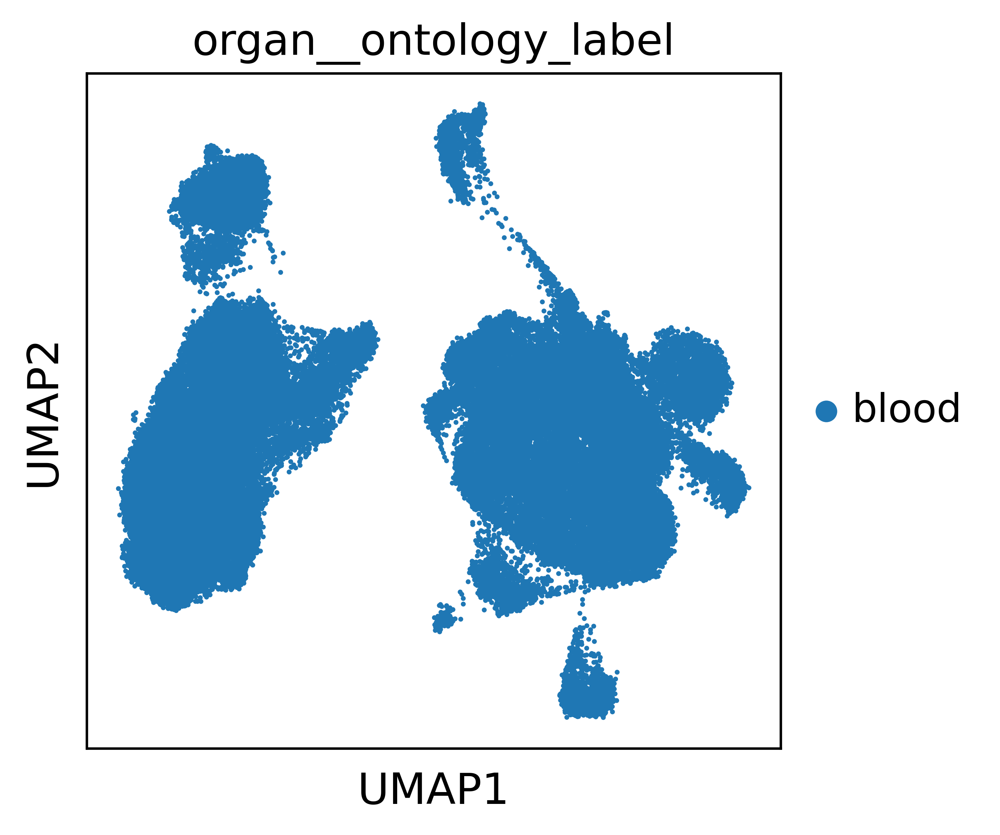

disease


/home/x_mamin/.conda/envs/lilliput_env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


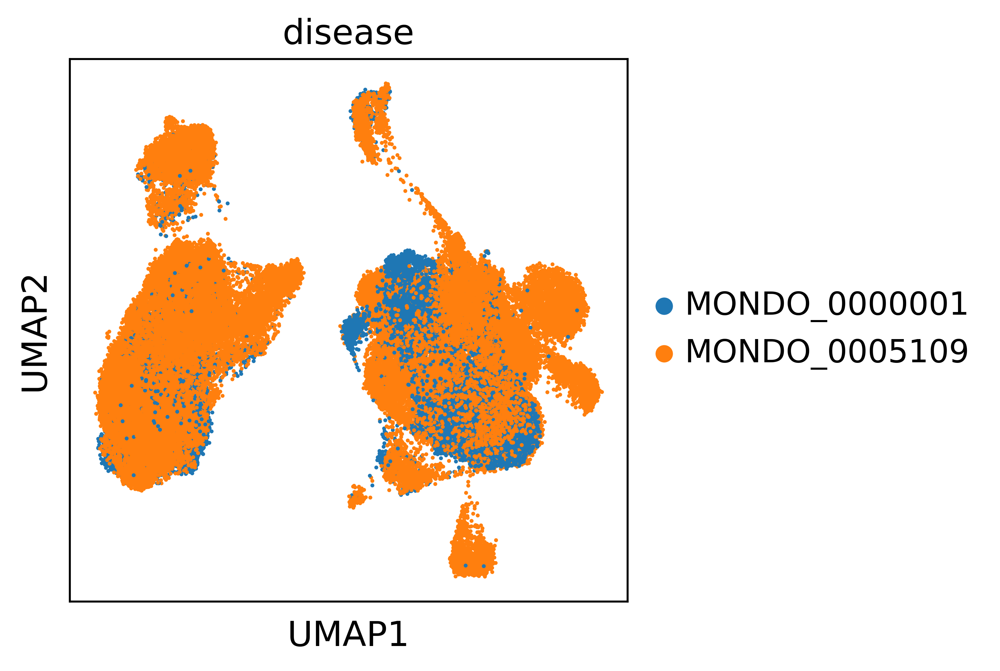

disease__ontology_label


/home/x_mamin/.conda/envs/lilliput_env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


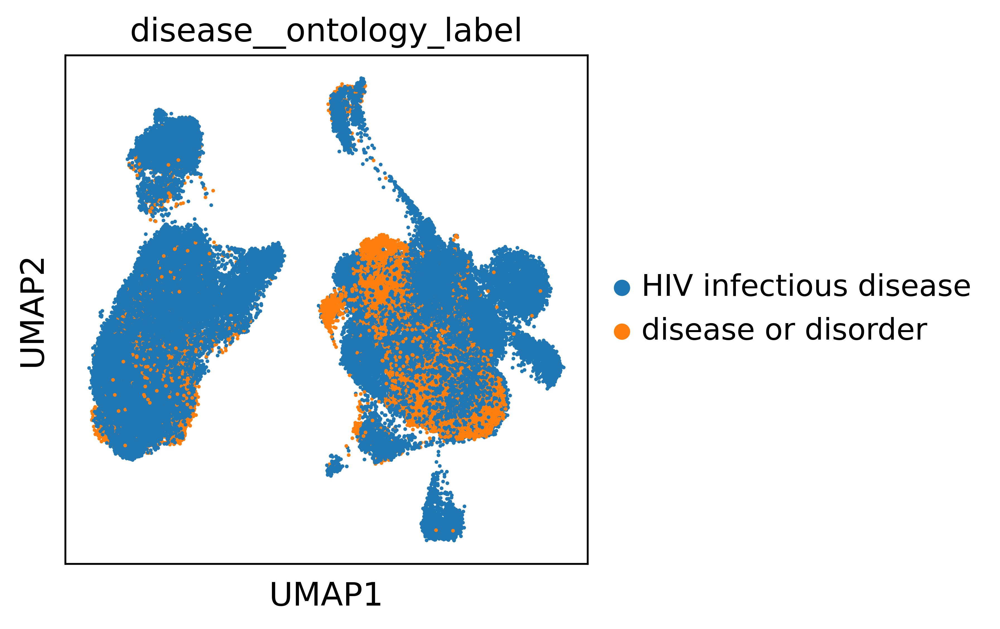

sample_type


/home/x_mamin/.conda/envs/lilliput_env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


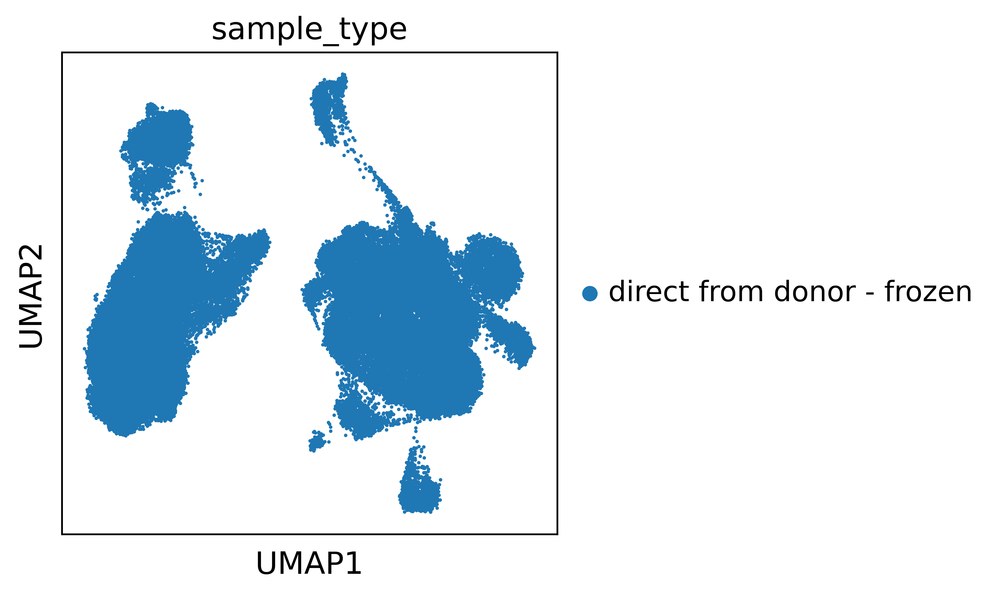

geographical_region


/home/x_mamin/.conda/envs/lilliput_env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


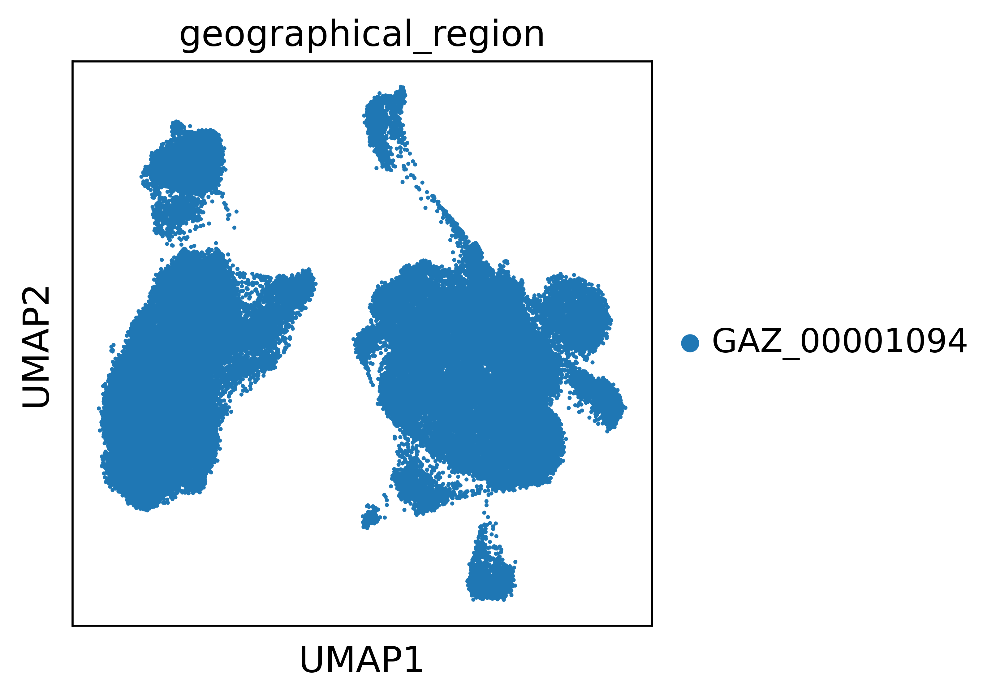

geographical_region__ontology_label


/home/x_mamin/.conda/envs/lilliput_env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


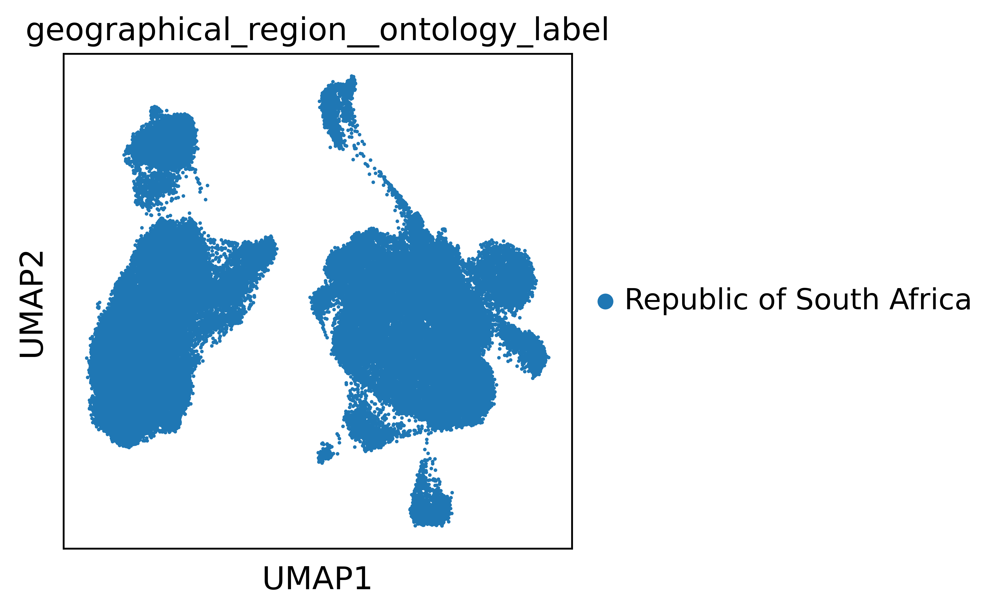

enrichment_method


/home/x_mamin/.conda/envs/lilliput_env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


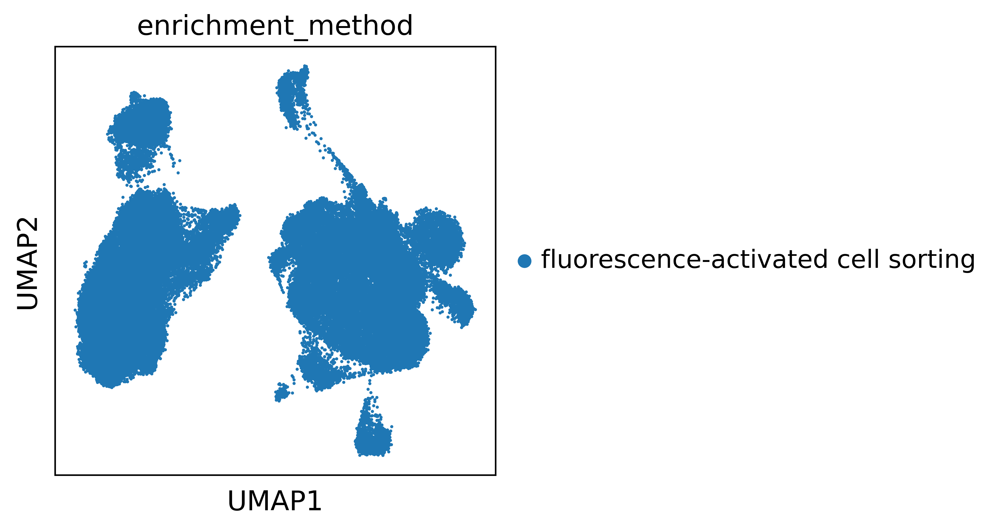

enrichment__facs_markers


/home/x_mamin/.conda/envs/lilliput_env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


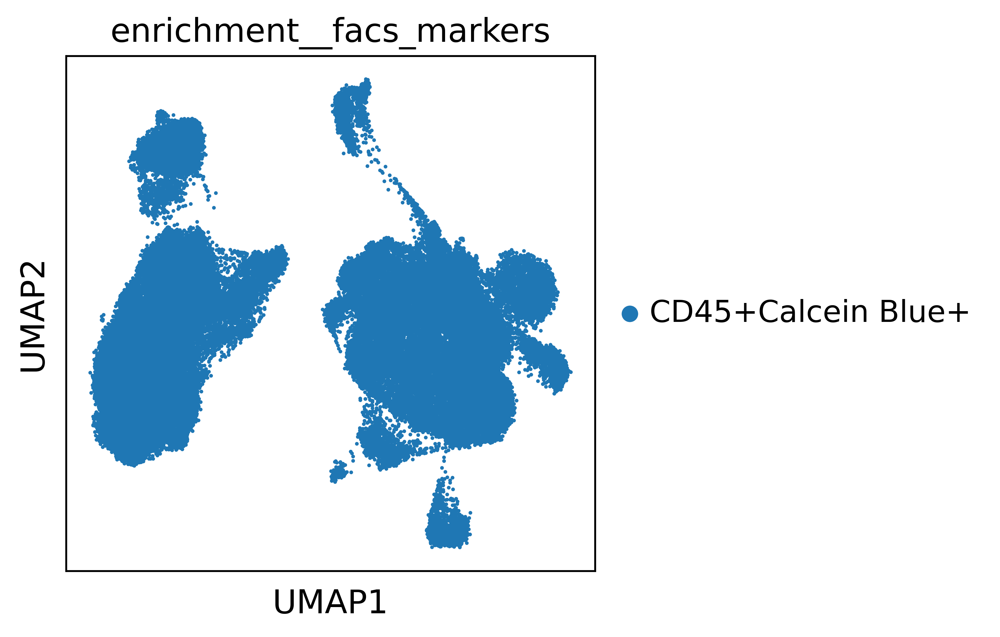

enrichment__cell_type


/home/x_mamin/.conda/envs/lilliput_env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


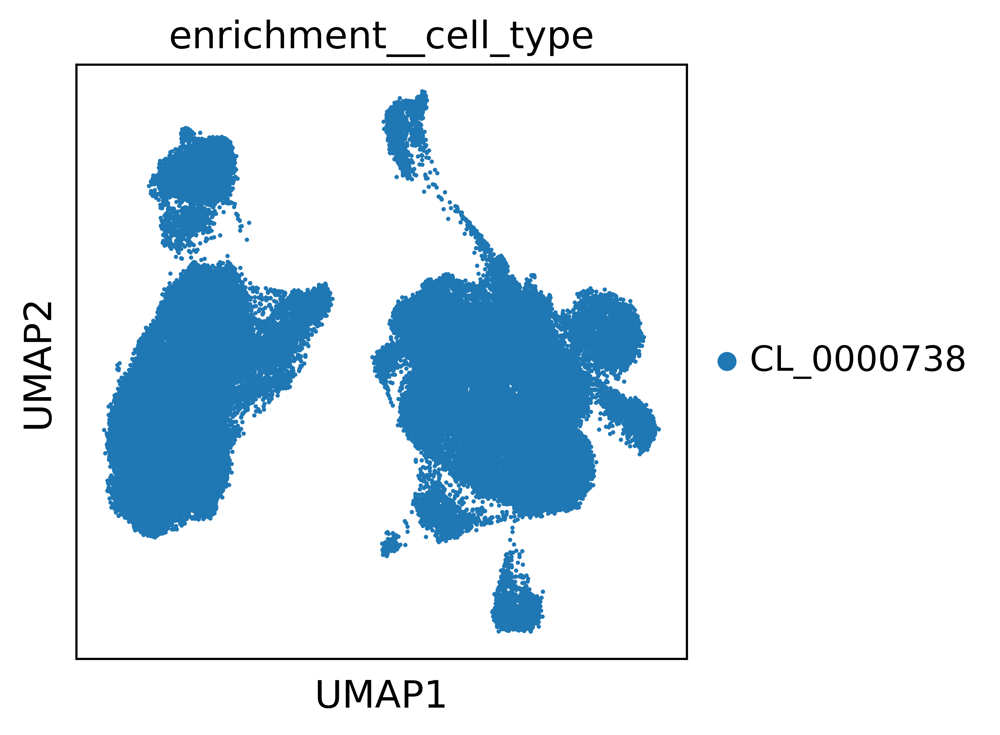

enrichment__cell_type__ontology_label


/home/x_mamin/.conda/envs/lilliput_env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


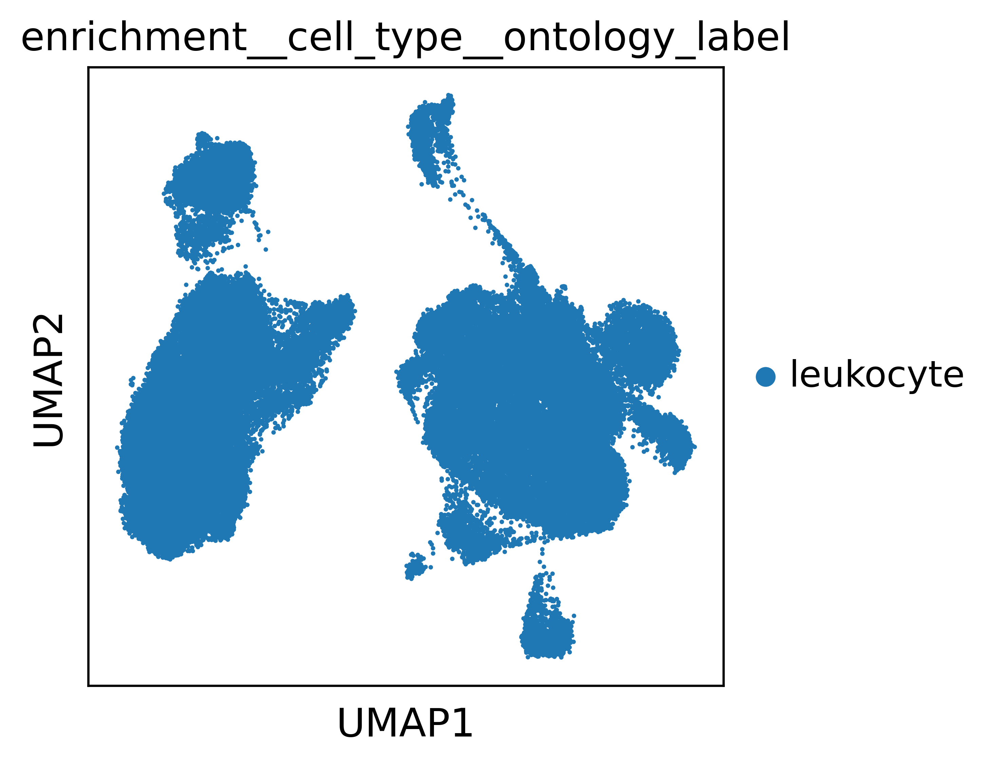

nUMI
CellID
biosample_id


/home/x_mamin/.conda/envs/lilliput_env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


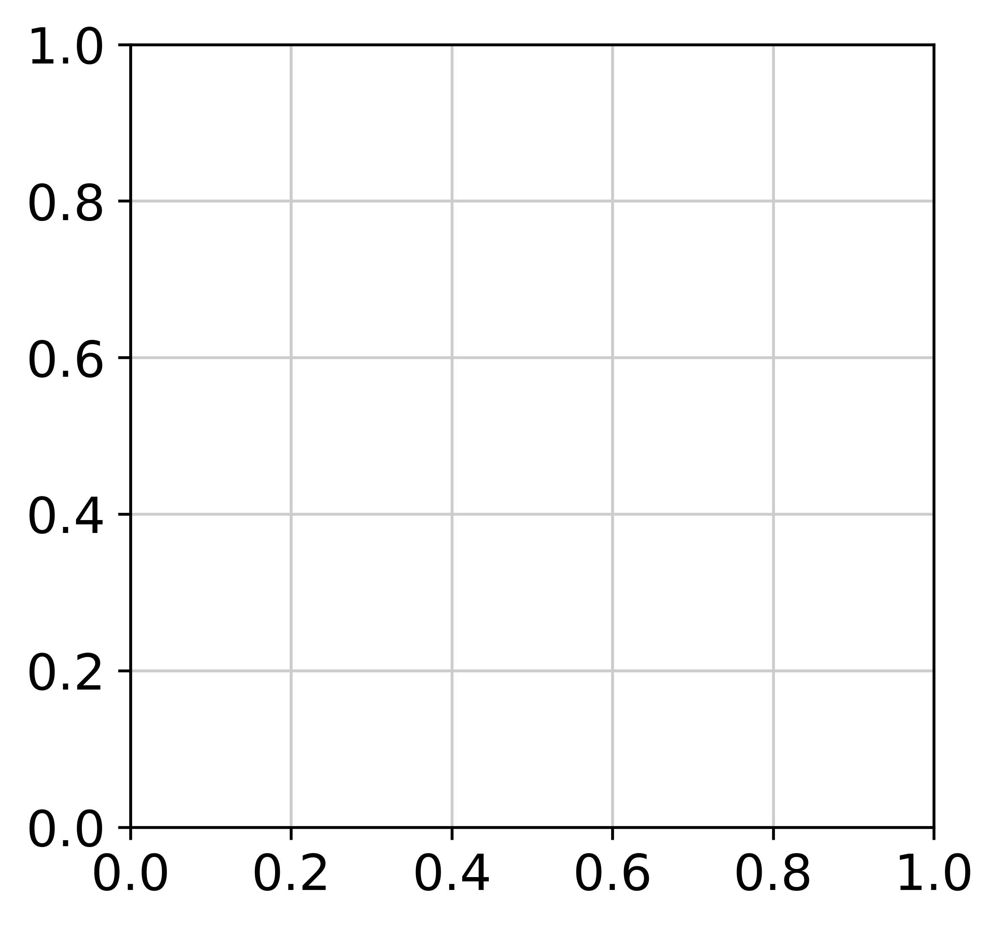

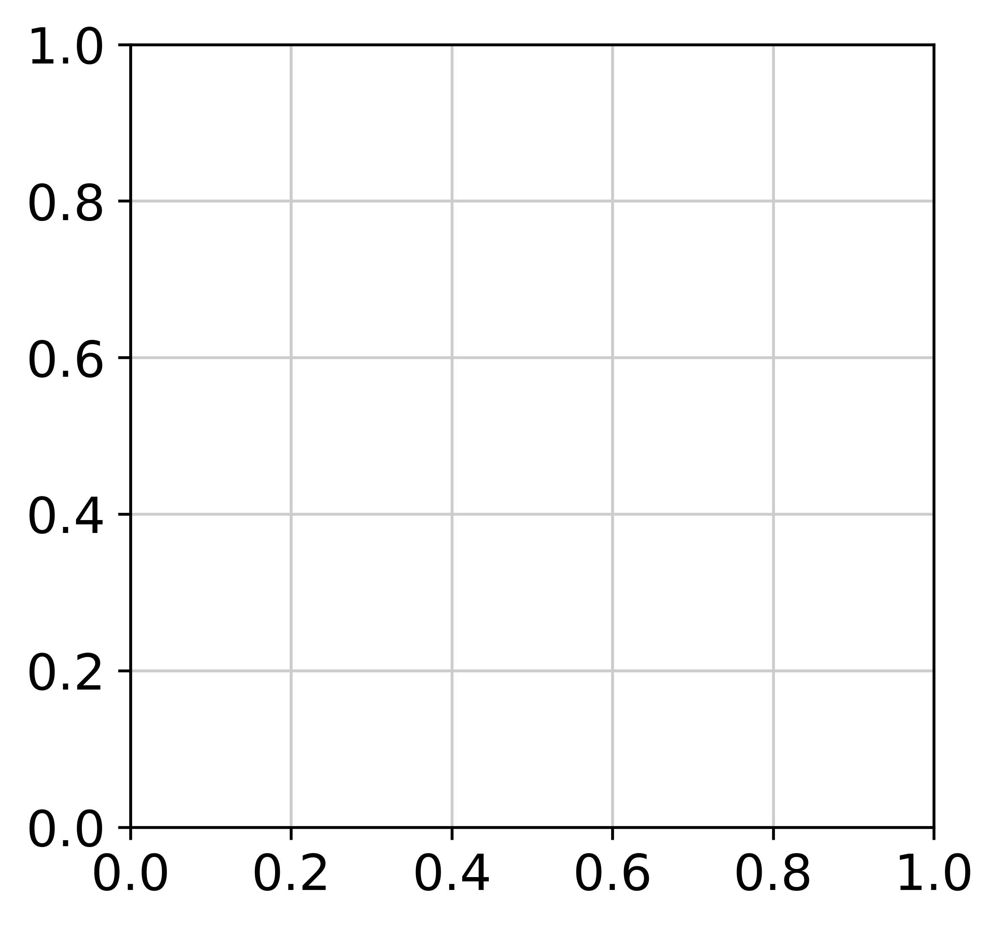

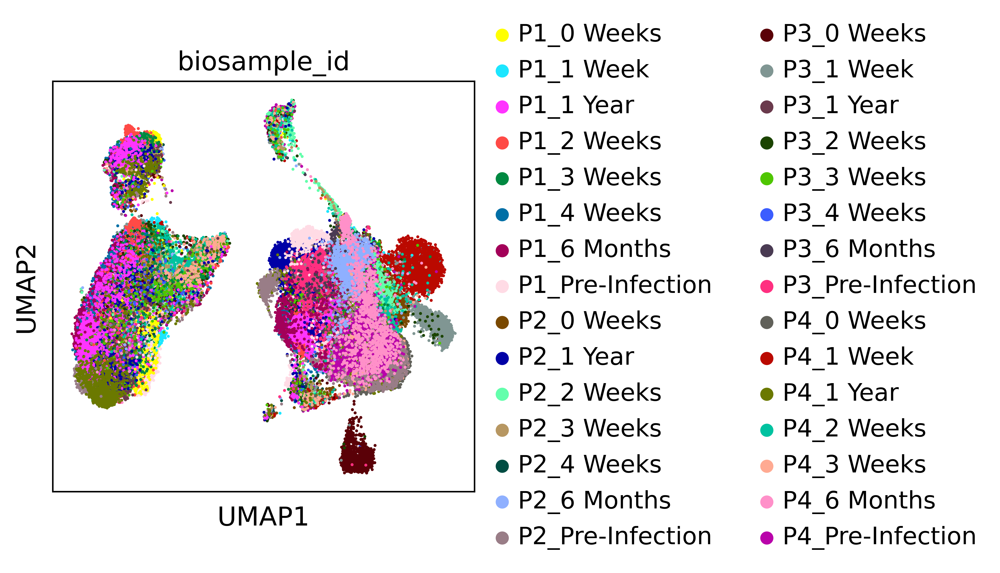

study_celltype_label


/home/x_mamin/.conda/envs/lilliput_env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


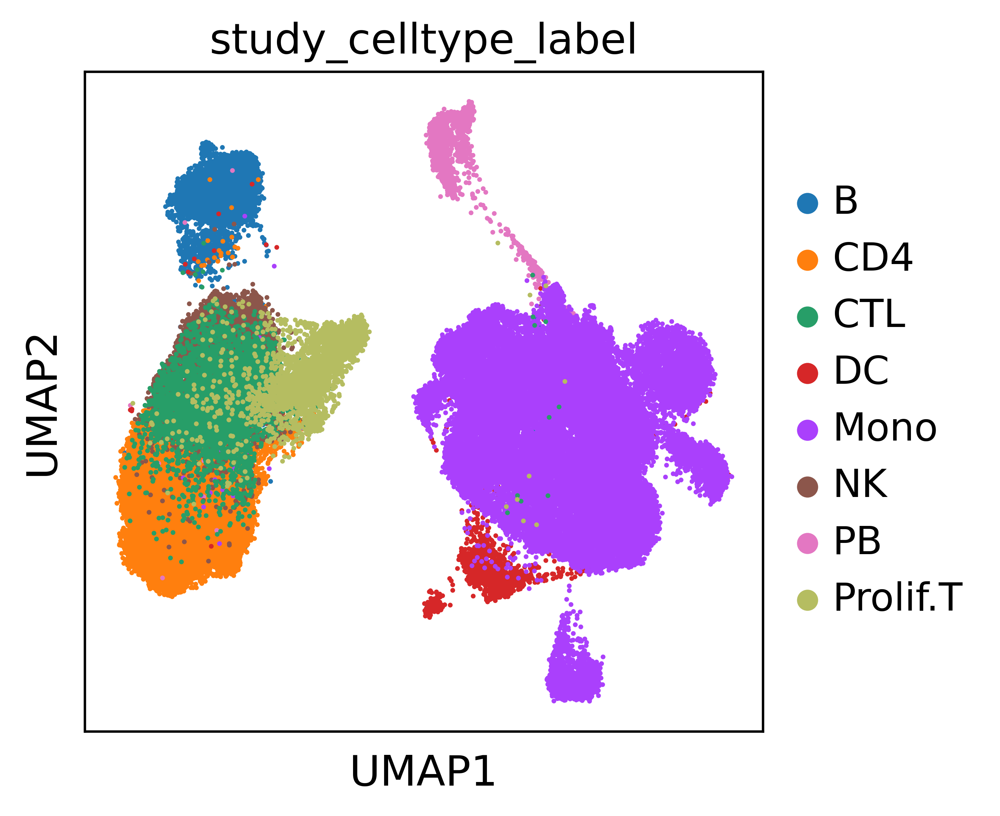

TimePoint


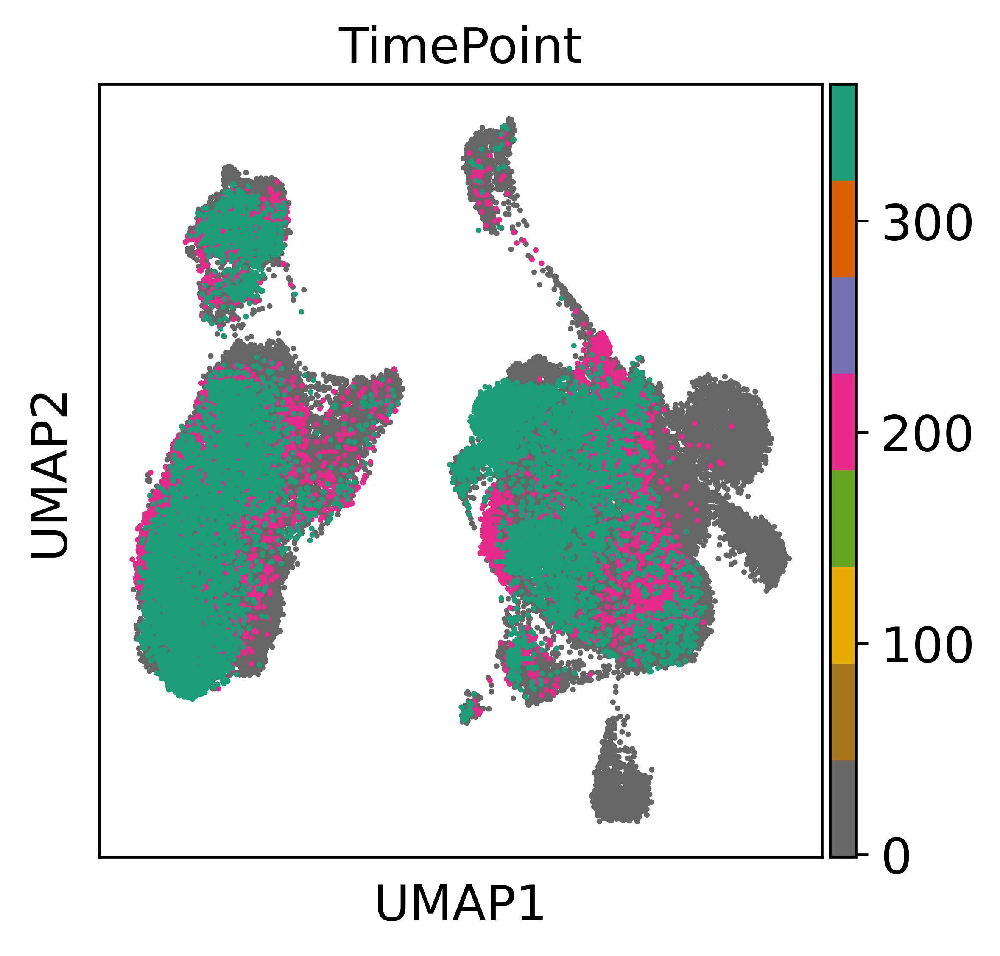

nGene
percent_mito
sequencing_instrument_manufacturer_model


/home/x_mamin/.conda/envs/lilliput_env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


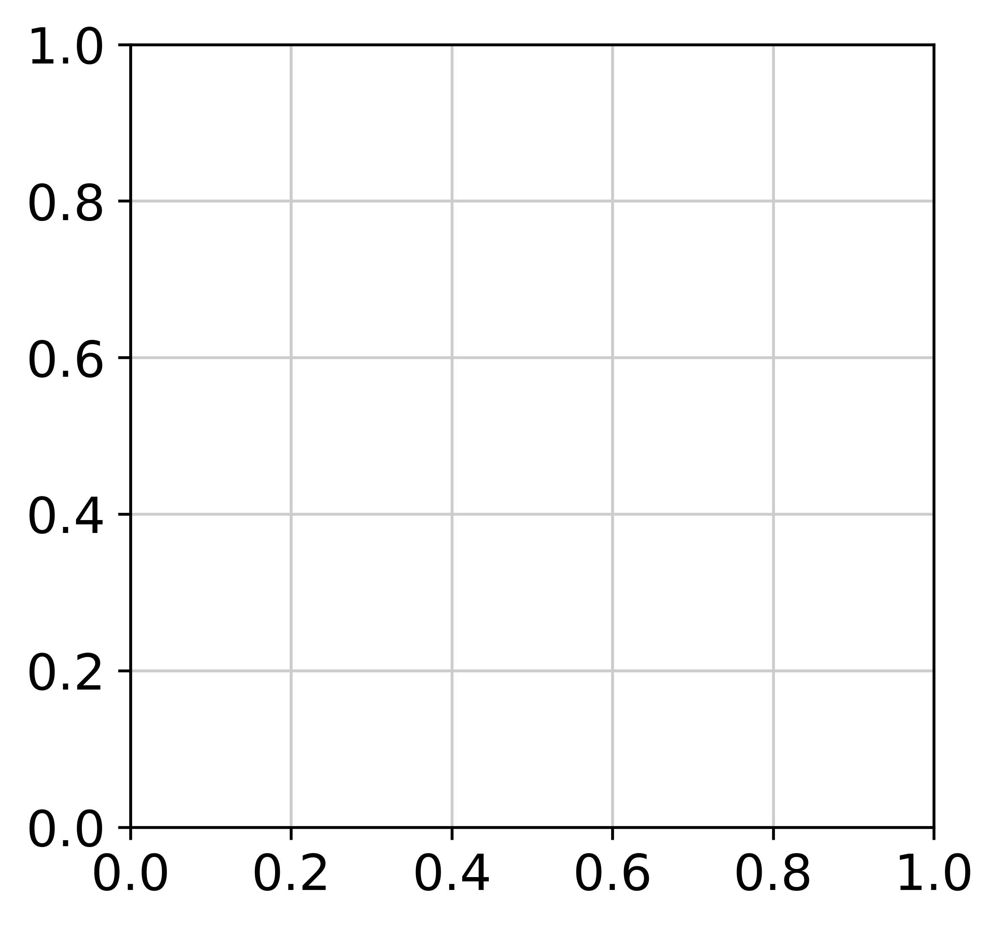

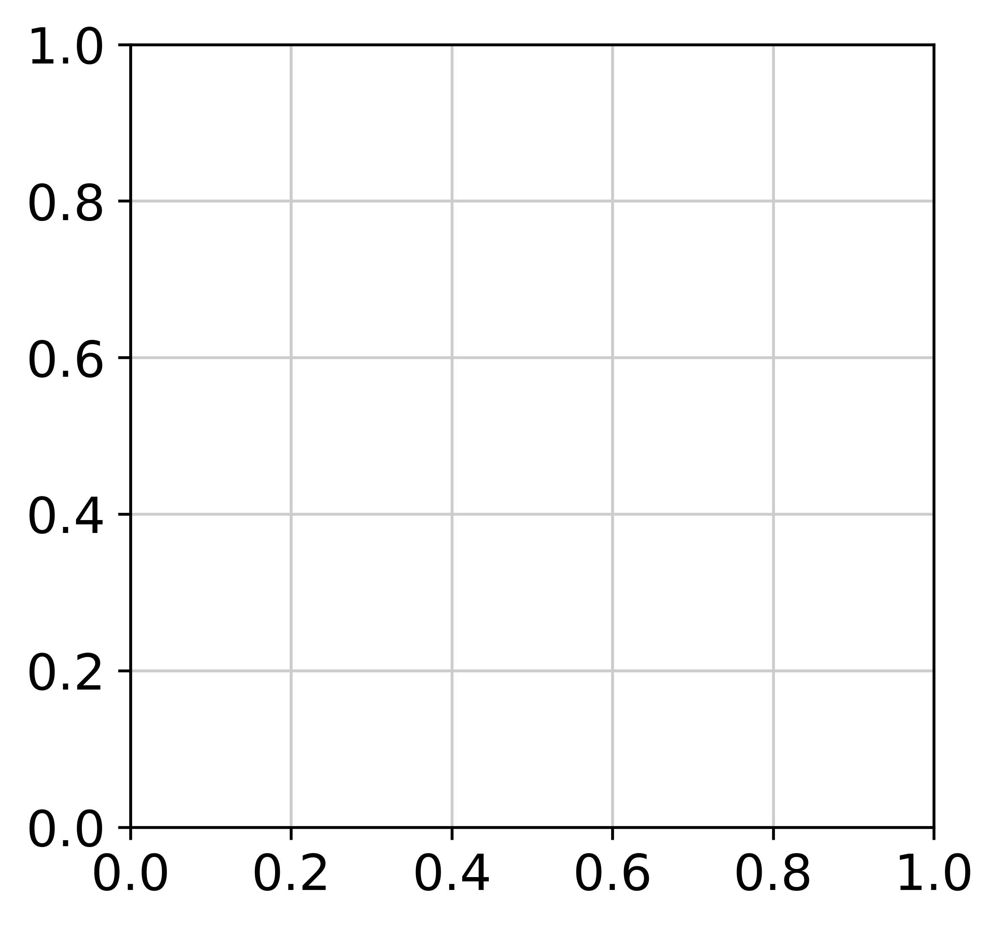

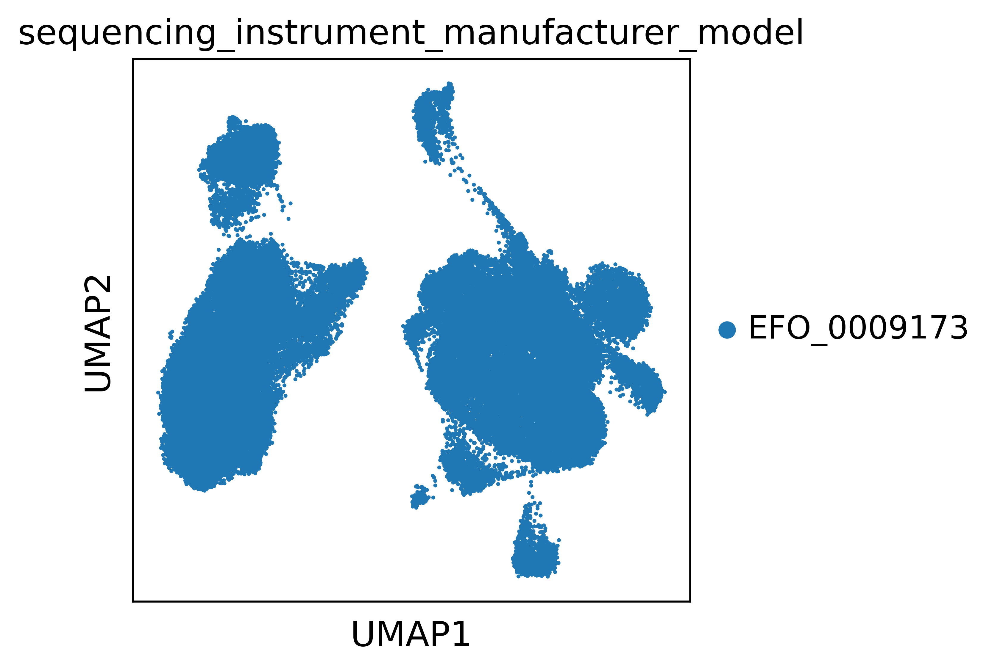

sequencing_instrument_manufacturer_model__ontology_label


/home/x_mamin/.conda/envs/lilliput_env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


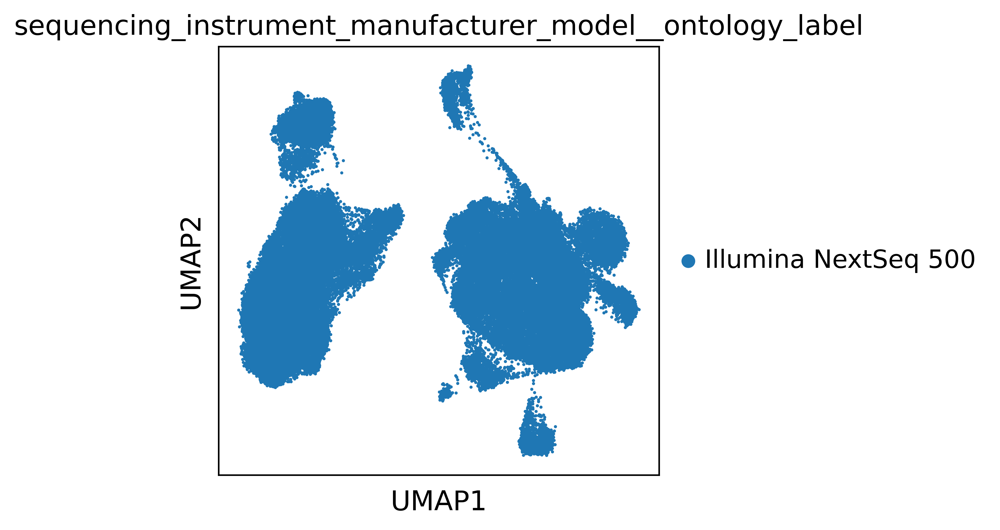

paired_ends
read_length


/home/x_mamin/.conda/envs/lilliput_env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


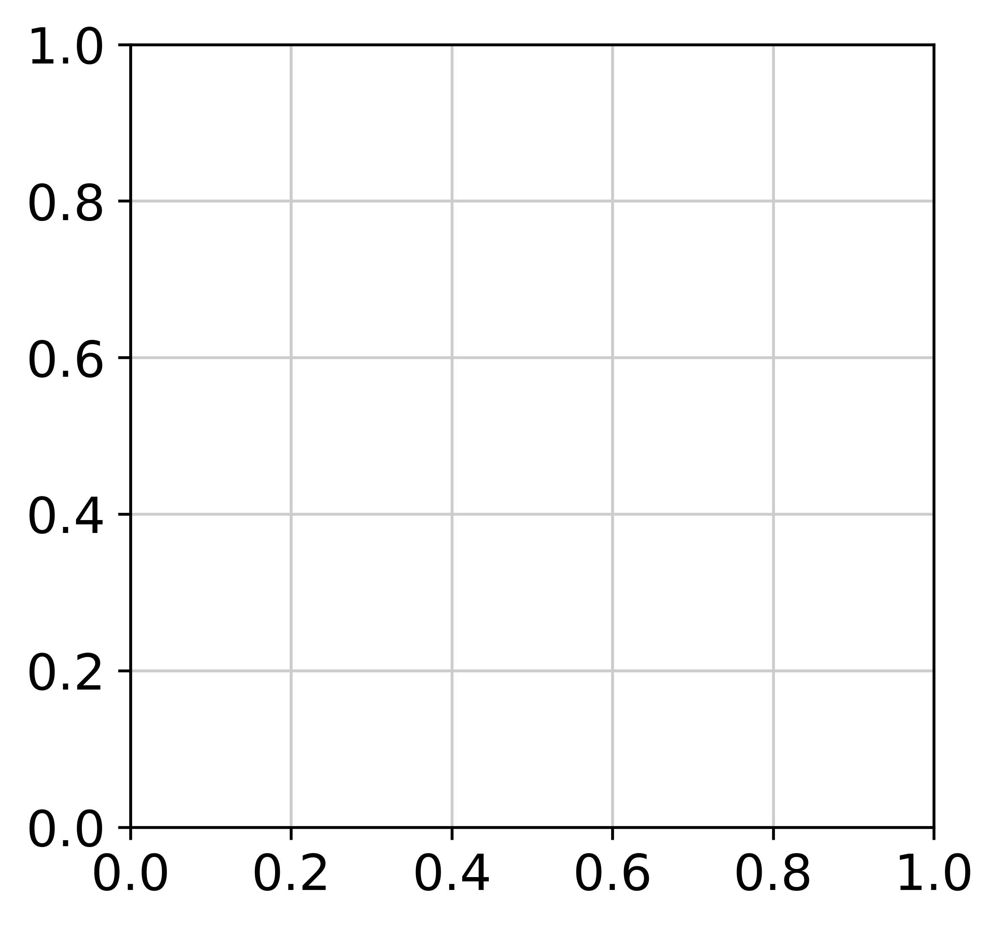

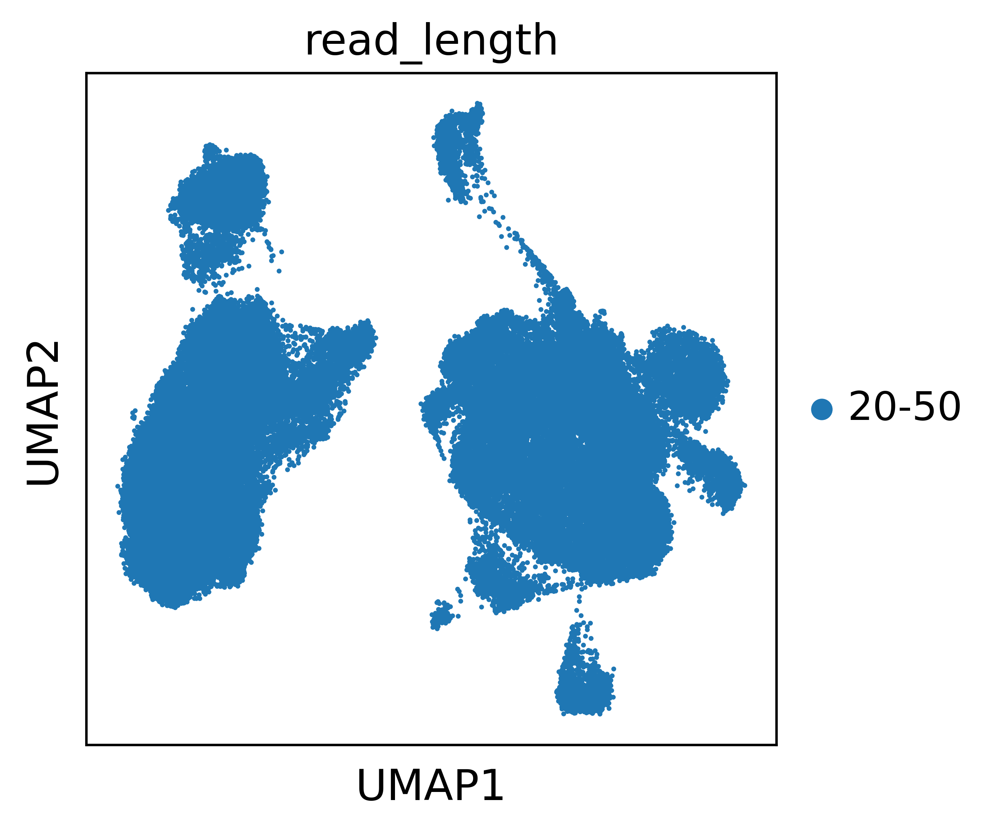

end_bias


/home/x_mamin/.conda/envs/lilliput_env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


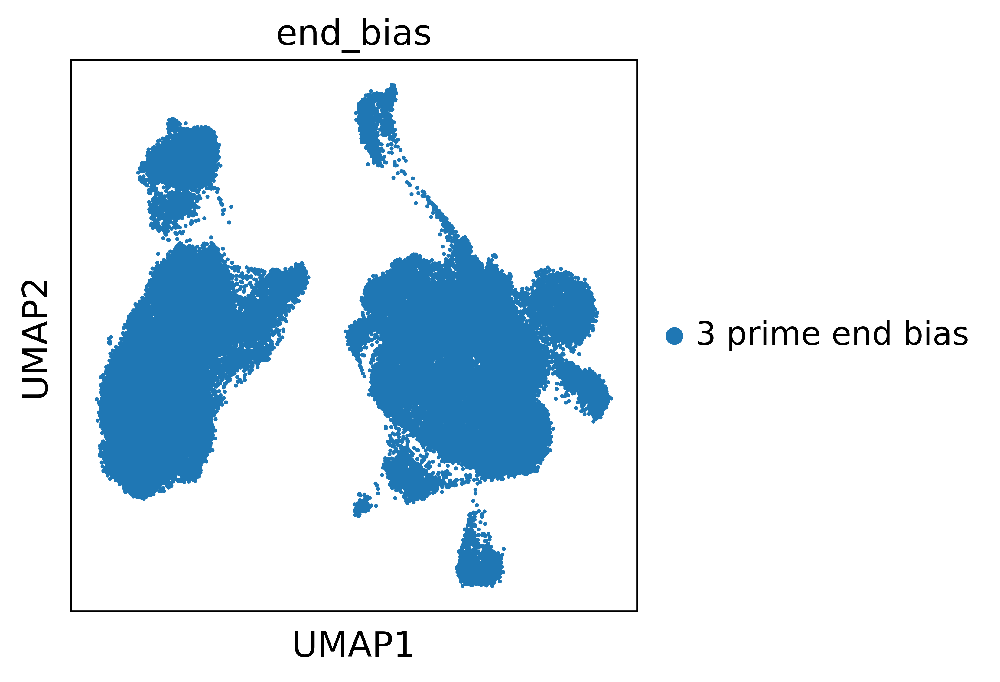

organism_age
organism_age__unit_label


/home/x_mamin/.conda/envs/lilliput_env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


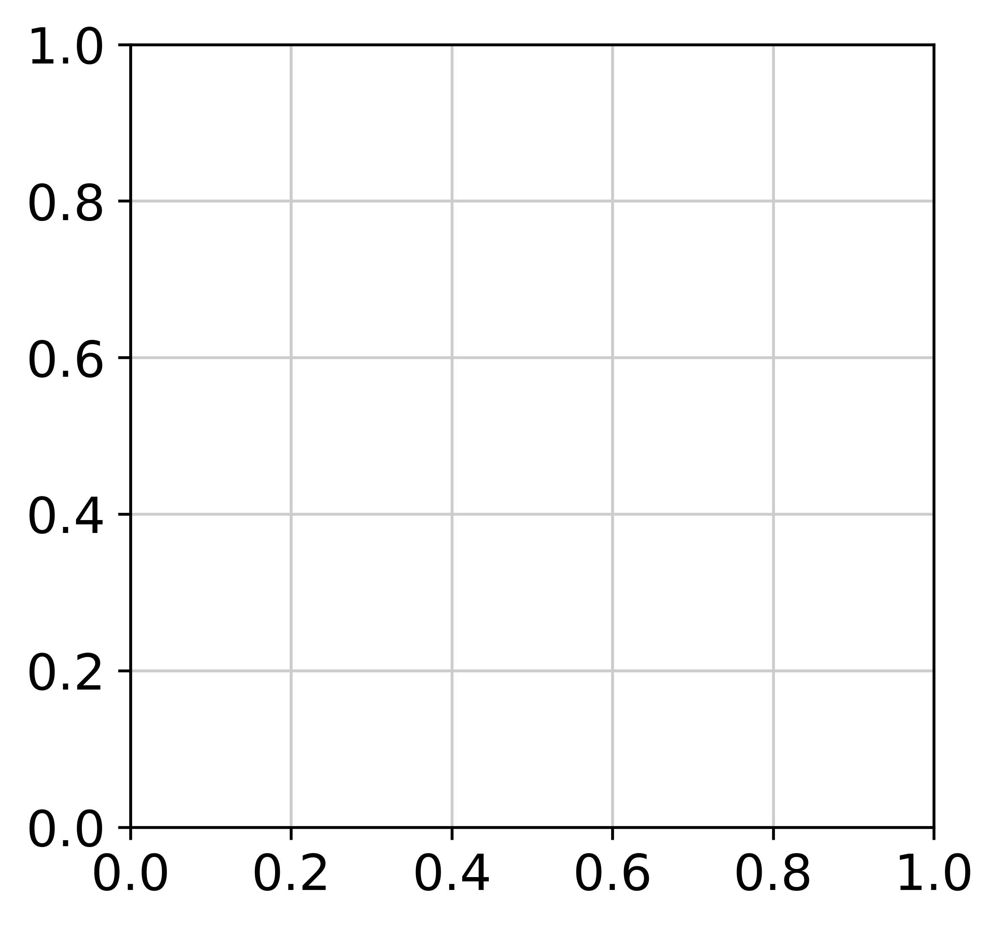

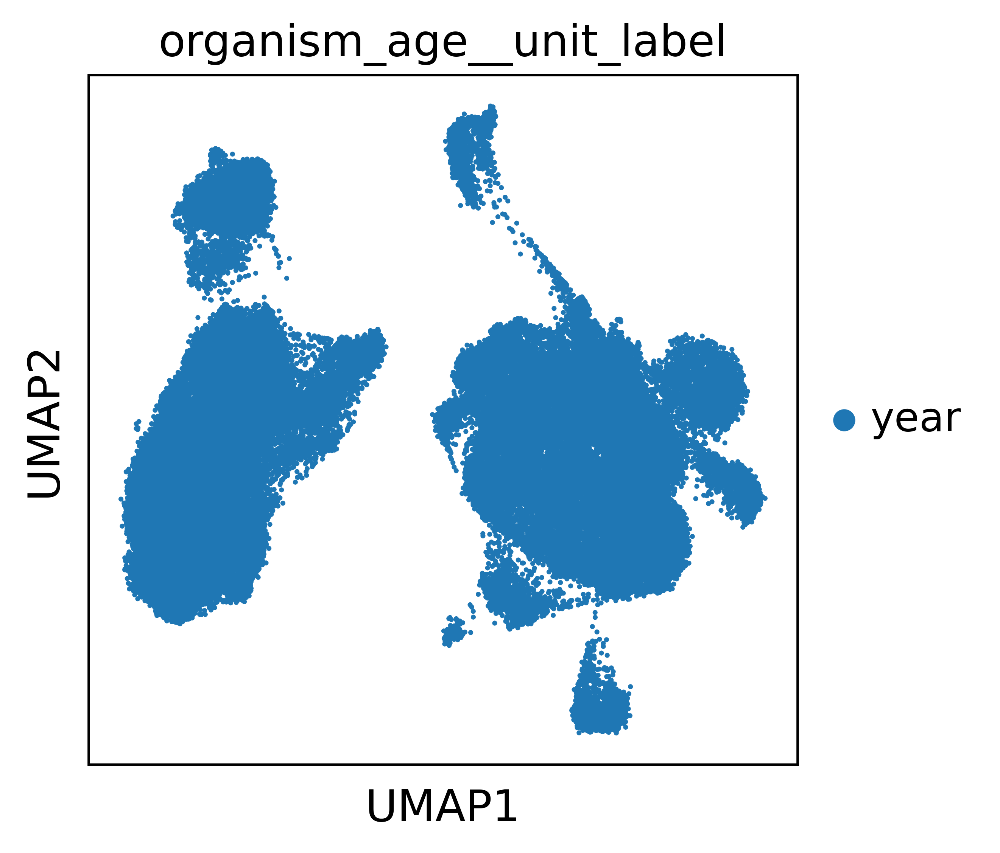

organism_age__unit


/home/x_mamin/.conda/envs/lilliput_env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


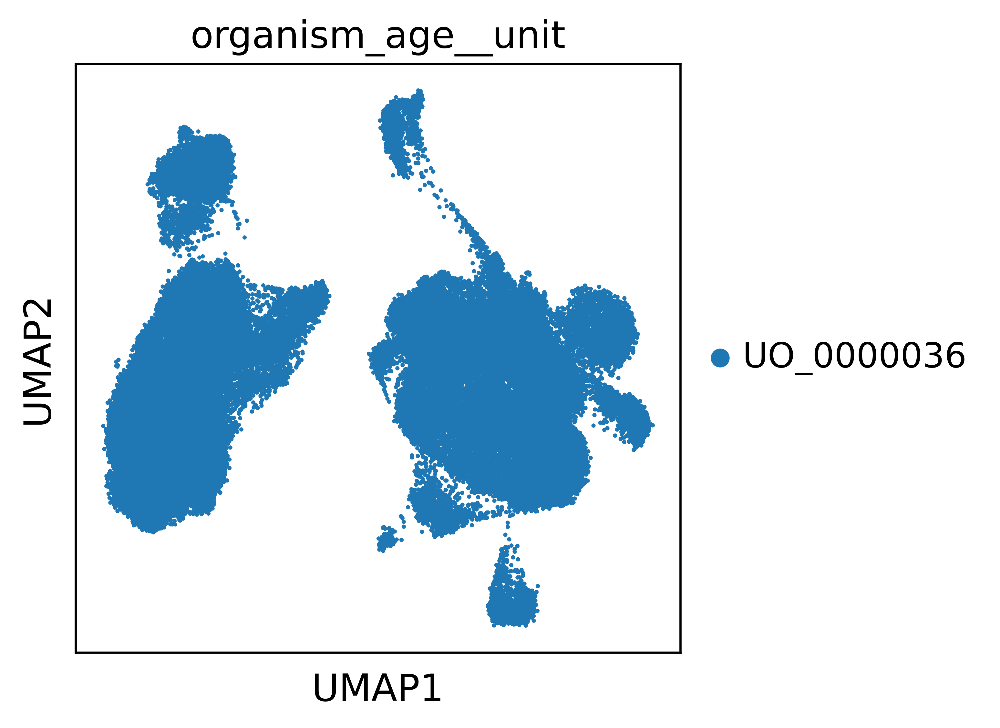

In [109]:
for key in adata.obs.keys()[1:]:
    try:
        print(key)
        sc.pl.umap(adata, color=key, color_map="Dark2_r", size=10)
    except:
        continue

In [12]:
adata.obs.keys()

Index(['NAME', 'species', 'species__ontology_label',
       'library_preparation_protocol',
       'library_preparation_protocol__ontology_label', 'donor_id', 'cell_type',
       'cell_type__ontology_label', 'is_living', 'sex', 'organ',
       'organ__ontology_label', 'disease', 'disease__ontology_label',
       'sample_type', 'geographical_region',
       'geographical_region__ontology_label', 'enrichment_method',
       'enrichment__facs_markers', 'enrichment__cell_type',
       'enrichment__cell_type__ontology_label', 'nUMI', 'CellID',
       'biosample_id', 'study_celltype_label', 'TimePoint', 'nGene',
       'percent_mito', 'sequencing_instrument_manufacturer_model',
       'sequencing_instrument_manufacturer_model__ontology_label',
       'paired_ends', 'read_length', 'end_bias', 'organism_age',
       'organism_age__unit_label', 'organism_age__unit', 'TimePoint_cont'],
      dtype='object')

In [13]:
plt.rcParams['figure.figsize'] = [20, 10]
adata_p4 = adata[adata.obs["donor_id"] == "P4"]
adata_p4_monocytes = adata_p4[adata_p4.obs["cell_type__ontology_label"] == "monocyte"]
sc.pl.umap(adata_p4_monocytes, color="TimePoint", color_map="Dark2_r", size=30)

/home/x_mamin/.conda/envs/lilliput_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1235: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/home/x_mamin/.conda/envs/lilliput_env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


In [14]:
sc.tl.rank_genes_groups(adata_p4_monocytes, 'TimePoint', method='wilcoxon')
# to visualize the results
sc.pl.rank_genes_groups(adata_p4_monocytes)

In [15]:
adata_p4_monocytes.uns['rank_genes_groups']

{'params': {'groupby': 'TimePoint',
  'reference': 'rest',
  'method': 'wilcoxon',
  'use_raw': False,
  'layer': None,
  'corr_method': 'benjamini-hochberg'},
 'names': rec.array([('RPS27', 'ISG15', 'MTRNR2L12', 'IL8', 'HLA-DRA', 'MTRNR2L1', 'NFKBIA'),
            ('RPL17', 'IFITM1', 'TPT1', 'DUSP1', 'GBP5', 'MTRNR2L8', 'G0S2'),
            ('RPL13A', 'IFITM3', 'MTRNR2L3', 'FOS', 'TPT1', 'MTRNR2L12', 'IL1B'),
            ...,
            ('GBP5', 'RPL30', 'APOBEC3A', 'RPL38', 'LY6E', 'ARPC1B', 'RPS15A'),
            ('GBP1', 'RPS8', 'ISG15', 'RPL37A', 'ISG15', 'SERF2', 'RPL41'),
            ('WARS', 'TPT1', 'IFITM3', 'TPT1', 'IFI6', 'IFI27', 'RPL13A')],
           dtype=[('0 Weeks', 'O'), ('1 Week', 'O'), ('1 Year', 'O'), ('2 Weeks', 'O'), ('3 Weeks', 'O'), ('6 Months', 'O'), ('Pre-Infection', 'O')]),
 'scores': rec.array([( 35.046387,  52.892616,  31.988993,  21.51831 ,  24.470308,  27.520882,  32.06269 ),
            ( 32.05528 ,  50.97301 ,  27.482056,  18.107656,  23.631516,  25.8

In [16]:
select_top_var = pd.DataFrame({"gene": adata_p4_monocytes.uns['rank_genes_groups']["names"]["1 Week"],
                               "score": adata_p4_monocytes.uns["rank_genes_groups"]["scores"]["1 Week"]})
select_top_var.head(20)

,gene,score
0,ISG15,52.892616
1,IFITM1,50.973011
2,IFITM3,47.129555
3,TNFSF10,46.794476
4,PLAC8,45.978413
5,IFI27,43.512829
6,LY6E,39.135708
7,IFIT3,39.068027
8,IFI6,37.213608
9,APOBEC3A,35.394436


In [17]:
enr = gp.enrichr(select_top_var["gene"].values[:21].tolist(), "Reactome_2022")

In [18]:
enr.results.head(10)

,Gene_set,Term,Overlap,P-value,Adjusted P-value,Old P-value,Old Adjusted P-value,Odds Ratio,Combined Score,Genes
0,Reactome_2022,Interferon Alpha/Beta Signaling R-HSA-909733,14/72,1.818311e-30,1.036437e-28,0,0,686.931034,47040.793121,IFITM3;IFITM1;RSAD2;MX1;IFI6;HLA-B;HLA-C;ISG15...
1,Reactome_2022,Interferon Signaling R-HSA-913531,16/200,1.056350e-28,3.010598e-27,0,0,344.260870,22176.446151,IFITM3;IFITM1;RSAD2;MX1;IFI6;HLA-B;HLA-C;ISG15...
2,Reactome_2022,Cytokine Signaling In Immune System R-HSA-1280215,16/702,7.754713e-20,1.473396e-18,0,0,89.996501,3960.152144,IFITM3;IFITM1;RSAD2;MX1;IFI6;HLA-B;HLA-C;ISG15...
3,Reactome_2022,Immune System R-HSA-168256,17/1943,2.344919e-14,3.341510e-13,0,0,39.836578,1250.228800,IFITM3;IFITM1;RSAD2;MX1;IFI6;HLA-B;HLA-C;ISG15...
4,Reactome_2022,Endosomal/Vacuolar Pathway R-HSA-1236977,4/11,2.948705e-10,3.361524e-09,0,0,671.327731,14731.941120,HLA-B;HLA-C;HLA-A;B2M
5,Reactome_2022,"Antigen Presentation: Folding, Assembly, Pepti...",4/28,1.808635e-08,1.718203e-07,0,0,195.637255,3487.842151,HLA-B;HLA-C;HLA-A;B2M
6,Reactome_2022,Interferon Gamma Signaling R-HSA-877300,5/89,2.995700e-08,2.439355e-07,0,0,74.014137,1282.184116,HLA-B;HLA-C;HLA-A;GBP1;B2M
7,Reactome_2022,SARS-CoV-2 Activates/Modulates Innate And Adap...,5/121,1.404393e-07,9.654676e-07,0,0,53.510237,844.310755,HLA-B;HLA-C;ISG15;HLA-A;B2M
8,Reactome_2022,Immunoregulatory Interactions Between A Lympho...,5/123,1.524423e-07,9.654676e-07,0,0,52.597987,825.603255,IFITM1;HLA-B;HLA-C;HLA-A;B2M
9,Reactome_2022,SARS-CoV-2-host Interactions R-HSA-9705683,5/196,1.538391e-06,8.768830e-06,0,0,32.375654,433.340795,HLA-B;HLA-C;ISG15;HLA-A;B2M


In [19]:
select_top_var_half_year = pd.DataFrame({"gene": adata_p4_monocytes.uns['rank_genes_groups']["names"]["6 Months"],
                               "score": adata_p4_monocytes.uns["rank_genes_groups"]["scores"]["6 Months"]})
select_top_var_half_year.head(20)

,gene,score
0,MTRNR2L1,27.520882
1,MTRNR2L8,25.830338
2,MTRNR2L12,19.806223
3,MTRNR2L2,18.953386
4,RPL23A,18.156956
5,RPS27A,17.477039
6,RPL26,17.326674
7,MTRNR2L3,16.757774
8,RPS29,14.822909
9,RPS15A,14.639650


In [20]:
enr_6m = gp.enrichr(select_top_var_half_year["gene"].values[:21].tolist(), "Reactome_2022")

In [21]:
enr_6m.results.head(10)

,Gene_set,Term,Overlap,P-value,Adjusted P-value,Old P-value,Old Adjusted P-value,Odds Ratio,Combined Score,Genes
0,Reactome_2022,Peptide Chain Elongation R-HSA-156902,13/86,1.313075e-26,4.629519e-24,0,0,443.113014,26407.249495,RPL41;RPL21;RPS8;RPS6;RPL23A;RPS3A;RPL7;EEF1A1...
1,Reactome_2022,Eukaryotic Translation Elongation R-HSA-156842,13/90,2.475679e-26,4.629519e-24,0,0,420.009740,24764.067405,RPL41;RPL21;RPS8;RPS6;RPL23A;RPS3A;RPL7;EEF1A1...
2,Reactome_2022,Viral mRNA Translation R-HSA-192823,12/90,9.131727e-24,6.830532e-22,0,0,340.188034,18047.072993,RPL41;RPS28;RPS15A;RPL21;RPS8;RPS29;RPS6;RPL23...
3,Reactome_2022,Selenocysteine Synthesis R-HSA-2408557,12/90,9.131727e-24,6.830532e-22,0,0,340.188034,18047.072993,RPL41;RPS28;RPS15A;RPL21;RPS8;RPS29;RPS6;RPL23...
4,Reactome_2022,Eukaryotic Translation Termination R-HSA-72764,12/90,9.131727e-24,6.830532e-22,0,0,340.188034,18047.072993,RPL41;RPS28;RPS15A;RPL21;RPS8;RPS29;RPS6;RPL23...
5,Reactome_2022,Nonsense Mediated Decay (NMD) Independent Of E...,12/92,1.208673e-23,7.534062e-22,0,0,331.650000,17501.148619,RPL41;RPS28;RPS15A;RPL21;RPS8;RPS29;RPS6;RPL23...
6,Reactome_2022,Formation Of A Pool Of Free 40S Subunits R-HSA...,12/98,2.699410e-23,1.261974e-21,0,0,308.418605,16027.411946,RPL41;RPS28;RPS15A;RPL21;RPS8;RPS29;RPS6;RPL23...
7,Reactome_2022,Response Of EIF2AK4 (GCN2) To Amino Acid Defic...,12/98,2.699410e-23,1.261974e-21,0,0,308.418605,16027.411946,RPL41;RPS28;RPS15A;RPL21;RPS8;RPS29;RPS6;RPL23...
8,Reactome_2022,L13a-mediated Translational Silencing Of Cerul...,12/108,9.228753e-23,3.451553e-21,0,0,276.152778,14011.200281,RPL41;RPS28;RPS15A;RPL21;RPS8;RPS29;RPS6;RPL23...
9,Reactome_2022,SRP-dependent Cotranslational Protein Targetin...,12/108,9.228753e-23,3.451553e-21,0,0,276.152778,14011.200281,RPL41;RPS28;RPS15A;RPL21;RPS8;RPS29;RPS6;RPL23...


## Pathways

In [23]:
# Pathways
genes = {
        "HSIAO_HOUSEKEEPING_GENES": ["AAMP","AARS1","ABLIM1","ACKR1","ACTB","ACTG1","AGPAT1","ALDOA","ANP32B",
                                     "ANXA11","ANXA2","AP3S1","APEX1","APLP2","ARAF","ARF1","ARF3","ARF4","ARHGAP1",
                                     "ARHGDIB","ARL6IP1","ARPC2","ATF4","ATIC","ATOX1","ATP5F1A","ATP5F1B","ATP5F1C",
                                     "ATP5MC1","ATP5MC2","ATP5MC3","ATP5PB","ATP6V1F","B2M","BCAP31","BCLAF1","BECN1",
                                     "BRD2","BTG2","BUD31","C1QBP","CALM2","CANX","CAP1","CAPN2","CAPNS1","CAPZA1",
                                     "CASC3","CAST","CCND2","CCNI","CCR9","CCT4","CD164","CD34","CD3E","CD63","CD74",
                                     "CD81","CES2","CETN2","CFL1","CHI3L2","CHKB","CIRBP","CLIC1","CLTA","CLTC","CLU",
                                     "COMT","COPA","COPS6","COX10","COX4I1","COX6A1","COX6B1","COX6C","COX7A2","COX7C",
                                     "COX8A","CSNK2B","CST3","CSTB","CTDSP2","CTNNB1","CYB5R3","DAZAP2","DCTN2","DDB1","DDT",
                                     "DDX39B","DDX5","DHPS","DSTN","DUSP1","DVL3","DYNLL1","ECHS1","EEF1A1","EEF1B2","EEF1D",
                                     "EEF1G","EEF2","EIF1","EIF3C","EIF3E","EIF3F","EIF4A1","EIF4A2","EIF4A3","EIF4G2",
                                     "EIF4H","ENO1","ERH","ESD","EZR","FAM193A","FAS","FBL","FCGRT","FHL1","FKBP1A","FKBP4",
                                     "FLNA","FMOD","FNTA","FTH1","FTL","FUCA1","FUS","FYN","GAPDH","GDI2","GLUL","GNAS",
                                     "GNB1","GPS1","GPS2","GPX4","GSTO1","GSTP1","GUSB","H2AC18","H2AZ1","H3-3A","H3-3B",
                                     "HDAC1","HINT1","HLA-A","HLA-B","HLA-DOA","HLA-DPA1","HLA-DQA1","HLA-DQB1","HLA-DRA",
                                     "HLA-E","HMGB1","HMGN2","HNRNPA1","HNRNPC","HNRNPF","HNRNPK","HNRNPL","HPN","HSP90AA1",
                                     "HSP90AB1","HSPB1","HSPD1","HTRA1","HYAL2","IFITM1","IFITM3","ILK","IQGAP1","IRAK1",
                                     "ISG20","ITGB1","ITPK1","JOSD1","JUNB","JUND","KARS1","KAT6A","LAMP1","LASP1","LDHA",
                                     "LDHB","LGALS1","LGALS3","LINC02967","LTA4H","MARCKS","MAZ","MDH1","MGP","MGST2","MLF2",
                                     "MLH1","MORF4L2","MPRIP","MSN","MT-RNR1","MT2A","MYH9","NACA","NAP1L1","NCL","NCOR2",
                                     "NCSTN","NDRG1","NDUFA12","NDUFA4","NDUFV2","NEDD8","NFIB","NFKBIA","NONO","NPC2",
                                     "NPIPB3","NPM1","OAZ1","OS9","PABPC1","PARP1","PAX6","PCBP2","PDLIM1","PEBP1","PFDN5",
                                     "PFN1","PGAM1","PGK1","PHB2","PI4KA","PIM1","PLP2","POLR2L","PPIA","PRDX1","PRDX6",
                                     "PSAP","PSD","PSEN1","PSMB2","PSMB3","PSMB4","PSMB5","PSMB6","PSMC1","PSMD2","PSMD7",
                                     "PSMD8","PSME1","PTDSS1","PTMA","PTP4A2","PTPN6","QARS1","RAC1","RACK1","RBPMS","RER1",
                                     "RFTN1","RHOA","RPA2","RPL10A","RPL11","RPL12","RPL13","RPL13A","RPL14","RPL17","RPL18",
                                     "RPL18A","RPL19","RPL21","RPL23","RPL23A","RPL24","RPL27","RPL27A","RPL28","RPL29",
                                     "RPL3","RPL31","RPL32","RPL34","RPL35","RPL35A","RPL36A","RPL36AL","RPL37A","RPL38",
                                     "RPL39","RPL4","RPL41","RPL6","RPL7","RPL7A","RPL8","RPL9P7","RPLP0","RPLP1","RPLP2",
                                     "RPN2","RPS10","RPS11","RPS14","RPS15","RPS15A","RPS16","RPS17","RPS18","RPS19","RPS2",
                                     "RPS21","RPS23","RPS25","RPS26","RPS27","RPS27A","RPS28","RPS29","RPS3","RPS3A","RPS5",
                                     "RPS6","RPS7","RPS8","RPS9","RPSA","S100A10","SARS1","SEC61B","SELENOW","SEPTIN2",
                                     "SERPINA3","SERPINB6","SET","SF1","SF3B2","SLC25A3","SLC25A5","SLC25A6","SLC6A8",
                                     "SNRNP70","SNRPD2","SNRPN","SOD1","SON","SPCS2","SPTBN1","SQSTM1","SRP14","SSB","SSR2",
                                     "STAT3","STMN1","STOM","SURF1","TAGLN2","TAX1BP1","TCEA1","TLE5","TMBIM6","TMED10",
                                     "TMSB10","TMSB4X","TPR","TPT1","TRAF4","TRIM28","TUBBP1","TXN","TXNIP","UBA1","UBA52",
                                     "UBB","UBC","UBE2C","UBE2D3","UQCRB","UQCRH","USP11","VDAC2","VIM","VPS72","WARS1",
                                     "XBP1","XPO1","YBX1","YWHAB","YWHAH","YWHAQ","YWHAZ","ZFP36","ZNF91"],
    
        "Reactome_TCA": ["ACO2", "CS", "DLD", "DLST", "FAHD1", "FH", "IDH2", "IDH3A", "IDH3B", 
                         "IDH3G", "MDH2", "ME2", "ME3", "NNT", "OGDH", "SDHA", "SDHB", "SDHC", 
                         "SDHD", "SUCLA2", "SUCLG1", "SUCLG2"]}
    

In [24]:
for pathway in enr.results.values[:10]:
    genes[pathway[1]] = pathway[-1].split(";")
genes.keys()

dict_keys(['HSIAO_HOUSEKEEPING_GENES', 'Reactome_TCA', 'Interferon Alpha/Beta Signaling R-HSA-909733', 'Interferon Signaling R-HSA-913531', 'Cytokine Signaling In Immune System R-HSA-1280215', 'Immune System R-HSA-168256', 'Endosomal/Vacuolar Pathway R-HSA-1236977', 'Antigen Presentation: Folding, Assembly, Peptide Loading Of Class I MHC R-HSA-983170', 'Interferon Gamma Signaling R-HSA-877300', 'SARS-CoV-2 Activates/Modulates Innate And Adaptive Immune Responses R-HSA-9705671', 'Immunoregulatory Interactions Between A Lymphoid And A non-Lymphoid Cell R-HSA-198933', 'SARS-CoV-2-host Interactions R-HSA-9705683'])

In [25]:
for pathway in enr_6m.results.values[:10]:
    genes[pathway[1]] = pathway[-1].split(";")
genes.keys()

dict_keys(['HSIAO_HOUSEKEEPING_GENES', 'Reactome_TCA', 'Interferon Alpha/Beta Signaling R-HSA-909733', 'Interferon Signaling R-HSA-913531', 'Cytokine Signaling In Immune System R-HSA-1280215', 'Immune System R-HSA-168256', 'Endosomal/Vacuolar Pathway R-HSA-1236977', 'Antigen Presentation: Folding, Assembly, Peptide Loading Of Class I MHC R-HSA-983170', 'Interferon Gamma Signaling R-HSA-877300', 'SARS-CoV-2 Activates/Modulates Innate And Adaptive Immune Responses R-HSA-9705671', 'Immunoregulatory Interactions Between A Lymphoid And A non-Lymphoid Cell R-HSA-198933', 'SARS-CoV-2-host Interactions R-HSA-9705683', 'Peptide Chain Elongation R-HSA-156902', 'Eukaryotic Translation Elongation R-HSA-156842', 'Viral mRNA Translation R-HSA-192823', 'Selenocysteine Synthesis R-HSA-2408557', 'Eukaryotic Translation Termination R-HSA-72764', 'Nonsense Mediated Decay (NMD) Independent Of Exon Junction Complex (EJC) R-HSA-975956', 'Formation Of A Pool Of Free 40S Subunits R-HSA-72689', 'Response Of EI

# SVD

In [26]:
# SVD
def perform_svd(adata, pathway, layer):
    print(len(list(set(genes[pathway]).intersection(set(adata.var.index)))))
    adata_subset = adata[:, list(set(genes[pathway]).intersection(set(adata.var.index)))].copy()
    eigengenes, s, eigensamples = svd(adata_subset.layers[layer], full_matrices=False)
    return adata_subset.obs["TimePoint_cont"], eigengenes

## Plotting and fitting

In [30]:
timepoints_tnf, eigengenes_tnf = perform_svd(adata_p4_monocytes, "Interferon Alpha/Beta Signaling R-HSA-909733", "counts")
plot = sns.scatterplot(timepoints_tnf, eigengenes_tnf[:, 0])
plot.set(xscale="symlog")
plt.xlabel("Time, days")
plt.ylabel("Pathway activity")


#plt.savefig("IFNA_IFNB_pathway_time_plot.png", dpi=300, bbox_inches='tight')

14


/home/x_mamin/.conda/envs/lilliput_env/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


Text(0, 0.5, 'Pathway activity')

In [144]:
sns.violinplot(timepoints_tnf, 
                eigengenes_tnf[:, 0])
plt.axhline(c='r')

/home/x_mamin/.conda/envs/lilliput_env/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


### TNF_SIGNALING_VIA_NFKB pathway

In [ ]:
plt.rcParams['figure.figsize'] = [20, 20]
fig, (ax1, ax2) = plt.subplots(nrows=2)
fig.suptitle("Interferon Alpha/Beta Signaling R-HSA-909733")

timepoints, eigengenes = perform_svd(adata_p4_monocytes, "Interferon Alpha/Beta Signaling R-HSA-909733", "counts")



int_time = []

model4 = np.poly1d(np.polyfit(timepoints, 
                              eigengenes[:, 0], 3))
    
    # plotting
sns.scatterplot(timepoints, eigengenes[:, 0], ax=ax1).set(xscale="symlog")
    
sns.lineplot(np.sort(timepoints), model4(np.sort(timepoints)), ax=ax1).set(xscale="symlog")    
ax1.set_ylim([np.min(eigengenes[:, 0]) - 0.05, np.max(eigengenes[:, 0]) + 0.05])
ax1.set_xlabel("Time")
ax1.set_ylabel("Pathway activity")
ax1.set_xticks([-1, 0, 7, 14, 21, 28, 182, 365])
ax1.set_xticklabels(["Pre-inf", "0 weeks", "1 week", "2 weeks", 
                     "3 weeks", "4 weeks", "6 months", "1 year"], rotation=45)
sns.violinplot(timepoints, 
                eigengenes[:, 0],
               ax=ax2)
plt.axhline(c='r')
ax2.set_xlabel("Time")
ax2.set_ylabel("Pathway activity")
ax2.set_xticklabels(["Pre-inf", "0 weeks", "1 week", "2 weeks", 
                     "3 weeks", "6 months", "1 year"], rotation=45)
plt.show()

In [86]:
for pathway in genes.keys():
    fig, (ax1, ax2) = plt.subplots(nrows=2)
    fig.suptitle(pathway)

    timepoints, eigengenes = perform_svd(adata_p4_monocytes, pathway, "counts")



    int_time = []

    model4 = np.poly1d(np.polyfit(timepoints, 
                                  eigengenes[:, 0], 3))

        # plotting
    sns.scatterplot(timepoints, eigengenes[:, 0], ax=ax1).set(xscale="symlog")
    
    sns.lineplot(np.sort(timepoints), model4(np.sort(timepoints)), ax=ax1)    
    ax1.set_ylim([np.min(eigengenes[:, 0]) - 0.05, np.max(eigengenes[:, 0]) + 0.05])
    ax1.set_xlabel("Time")
    ax1.set_ylabel("Pathway activity")
    ax1.set_xticks([-1, 0, 7, 14, 21, 28, 182, 365])
    ax1.set_xticklabels(["Pre-inf", "0 weeks", "1 week", "2 weeks", 
                         "3 weeks", "4 weeks", "6 months", "1 year"], rotation=45)
    sns.violinplot(timepoints, 
                    eigengenes[:, 0],
                   ax=ax2)
    plt.axhline(c='r')
    ax2.set_xlabel("Time")
    ax2.set_ylabel("Pathway activity")
    ax2.set_xticklabels(["Pre-inf", "0 weeks", "1 week", "2 weeks", 
                     "3 weeks", "6 months", "1 year"], rotation=45)
    plt.show()

367


/home/x_mamin/.conda/envs/lilliput_env/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/home/x_mamin/.conda/envs/lilliput_env/lib/python3.9/site-packages/seaborn/categorical.py:3775: UserWarning: catplot is a figure-level function and does not accept target axes. You may wish to try stripplot
  warnings.warn(msg, UserWarning)


TypeError: object of type 'NoneType' has no len()

## Perform permutations

In [58]:
def permute_timestamps(adata):
    indeces = np.random.randint(0, adata.shape[0], adata.shape[0])
    adata.obs["TimePoint"] = adata.obs["TimePoint"][indeces].values
    adata.obs["TimePoint_cont"] = adata.obs["TimePoint_cont"][indeces].values
    return adata

In [90]:
plt.rcParams['figure.figsize'] = [20, 20]
fig, (ax1, ax2) = plt.subplots(nrows=2)
fig.suptitle("Interferon Alpha/Beta Signaling R-HSA-909733")

adata_p4_monocytes_no_1y = adata_p4_monocytes[adata_p4_monocytes.obs["TimePoint"] != "1 Year", ]


timepoints, eigengenes = perform_svd(adata_p4_monocytes_no_1y, "Interferon Alpha/Beta Signaling R-HSA-909733", "counts")
adata_p4_monocytes_no_1y_perm = permute_timestamps(adata_p4_monocytes_no_1y)
timepoints_perm, eigengenes_perm = perform_svd(adata_p4_monocytes_no_1y_perm, "Interferon Alpha/Beta Signaling R-HSA-909733", "counts")



to_plot = pd.DataFrame({'x': timepoints, 
                        'y': eigengenes[:, 0], 
                        'test': "true"})
to_plot = pd.concat([to_plot, pd.DataFrame({'x': timepoints_perm, 
                                            'y': eigengenes_perm[:, 0], 
                                            'test': "perm"})])
  
# plotting
sns.stripplot(data=to_plot, x='x', y='y', hue='test', ax=ax1, dodge=True).set(xscale="symlog")    

ax1.set_ylim([np.min(eigengenes[:, 0]) - 0.05, np.max(eigengenes[:, 0]) + 0.05])
ax1.set_xlabel("Time")
ax1.set_ylabel("Pathway activity")
#ax1.set_xticks([-1, 0, 7, 14, 21, 28, 182])
#ax1.set_xticklabels(["Pre-inf", "0 weeks", "1 week", "2 weeks", 
#                     "3 weeks", "4 weeks", "6 months"], rotation=45)
sns.violinplot(data=to_plot, x='x', y='y', c="x", hue="test", ax=ax2)

plt.axhline(c='r')
ax2.set_xlabel("Time")
ax2.set_ylabel("Pathway activity")
#ax2.set_xticklabels(["Pre-inf", "0 weeks", "1 week", "2 weeks", 
#                     "3 weeks", "6 months"], rotation=45)
plt.show()

14


/tmp/ipykernel_392428/2159851215.py:3: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs["TimePoint"] = adata.obs["TimePoint"][indeces].values


14
